# Correction du notebook précédent + Test d'autres mémoires

In [2]:
import numpy as np
import matplotlib.pyplot as plt
from lal import MSUN_SI, MTSUN_SI, PC_SI, C_SI, G_SI
from pycbc.waveform import get_td_waveform, get_td_waveform_modes
from pycbc.filter import highpass, lowpass
from pycbc.types import TimeSeries
from sympy.physics.wigner import wigner_3j
import gwmemory
from scipy.fft import fft, fftfreq
from matplotlib import cm
from tqdm import tqdm
from matplotlib.gridspec import GridSpec
from mpl_toolkits.axes_grid1.inset_locator import inset_axes
from matplotlib.ticker import MultipleLocator, AutoMinorLocator, FormatStrFormatter
from matplotlib.offsetbox import OffsetImage, AnnotationBbox
from gwpy.timeseries import TimeSeries as GWpyTimeSeries
from IPython.display import HTML
from matplotlib import animation
from matplotlib.animation import PillowWriter

/tmp/ipykernel_1474/4198324317.py:3: UserWarning: Wswiglal-redir-stdio:

SWIGLAL standard output/error redirection is enabled in IPython.
This may lead to performance penalties. To disable locally, use:

with lal.no_swig_redirect_standard_output_error():
    ...

To disable globally, use:

lal.swig_redirect_standard_output_error(False)

Note however that this will likely lead to error messages from
LAL functions being either misdirected or lost when called from
Jupyter notebooks.

To suppress this warning, use:

import warnings
warnings.filterwarnings("ignore", "Wswiglal-redir-stdio")
import lal

  from lal import MSUN_SI, MTSUN_SI, PC_SI, C_SI, G_SI
/usr/local/lib/python3.11/site-packages/pykerr/qnm.py:2: UserWarning: pkg_resources is deprecated as an API. See https://setuptools.pypa.io/en/latest/pkg_resources.html. The pkg_resources package is slated for removal as early as 2025-11-30. Refrain from using this package or pin to Setuptools<81.
  import pkg_resources


In [3]:
# Calcul du Spin-weighted spherical harmonic modes (l,m)
# Définition sur base de l'article : https://arxiv.org/pdf/0812.0069#page=5.61
def fac(n): # Défini n! 
    if n==0 or n==1:
        return 1
    result = 1
    for i in range(2, n+1):
        result *= i
    return result

def dlms(l, m, s, Theta): # eq (2.14)
    
    sq = np.sqrt(fac(l+m)*fac(l-m)*fac(l+s)*fac(l-s))
    d = 0.
    for k in range(max(0,m-s),min(l+m,l-s)+1):
        d = d + (-1.)**k*np.sin(Theta/2.)**(2.*k+s-m)*np.cos(Theta/2.)**(2.*l+m-s-2.*k)/(fac(k)*fac(l+m-k)*fac(l-s-k)*fac(s-m+k))
    return sq*d

def sYlm(s,l,m,Theta,Phi): # eq (2.13)
    
    res = (-1.)**(-s)*np.sqrt((2.*l+1)/(4*np.pi))*dlms(l,m,-s,Theta)
    
    if res==0:
        return 0
    else:
        return complex(res*np.cos(m*Phi), res*np.sin(m*Phi)) # e^(imPhi)

Plot de la waveform + mémoire

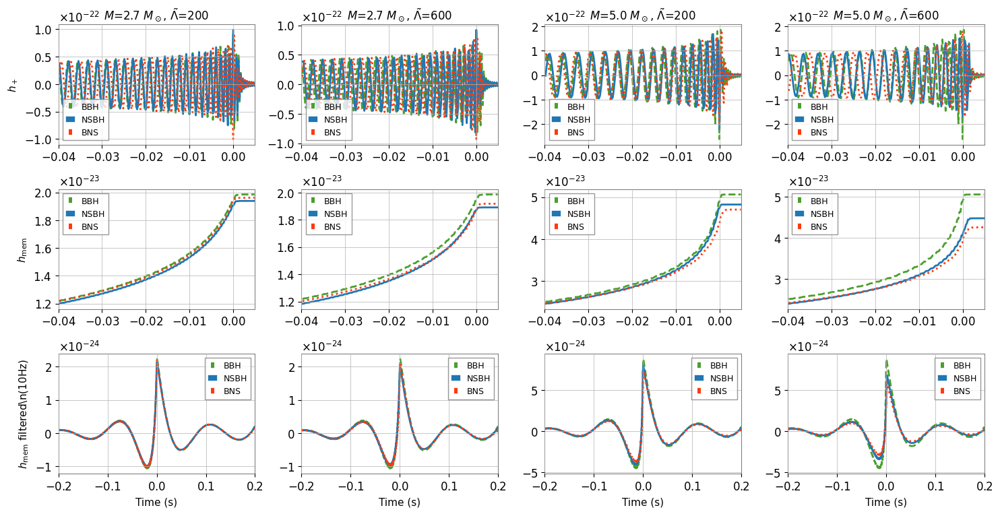

In [4]:
# Constantes 
deltaT = 1.0/4096 # Sample rate
inclination = np.pi/2 # Vue edge-on
distance = 100.0 # Mpc

def generate_waveform_extended(mtot, lam_tilde, system, extension_time=0.2):
    """
    Génère une forme d'onde étendue avec post-merger pour la mémoire
    """
    m1 = m2 = mtot/2.0
    
    if system == "BNS":
        approximant = "SEOBNRv4_ROM_NRTidalv2"
        lambda1 = lambda2 =  lam_tilde
    elif system == "BBH":
        approximant = "SEOBNRv4_ROM_NRTidalv2"
        lambda1 = lambda2 = 0
    elif system == "NSBH":
        approximant = "SEOBNRv4_ROM_NRTidalv2_NSBH"
        lambda1 = 0
        lambda2 = lam_tilde/2 # Correction vu la formule de Lambda_tilde avec lambda_1 = 0
    else:
        raise ValueError(f"Système non reconnu: {system}")

    # Génération sans spécifier tc
    hp, hc = get_td_waveform(
        approximant=approximant,
        mass1=m1, mass2=m2,
        lambda1=lambda1, lambda2=lambda2,
        delta_t=deltaT,
        f_lower=20.,
        distance=distance, 
        inclination=inclination, 
    )
    
    # Conversion en arrays numpy
    hp_orig = hp.numpy()
    hc_orig = hc.numpy()
    
    # Grille temporelle originale
    t_orig = hp.sample_times.numpy()
    
    # ALIGNEMENT MANUEL: trouver le maximum d'amplitude et décaler pour mettre à t=0
    amplitude = np.abs(hp_orig)
    merger_idx = np.argmax(amplitude) # On associe le merger au max 
    merger_time = t_orig[merger_idx]
    
    # Décaler le temps pour mettre le merger à t=0
    t_aligned = t_orig - merger_time
    
    # Extension post-merger
    n_extension = int(extension_time / deltaT)
    hp_extension = np.zeros(n_extension)
    hc_extension = np.zeros(n_extension)
    
    # Temps d'extension
    t_extension = np.arange(1, n_extension + 1) * deltaT + t_aligned[-1]
    
    # Concaténation
    t_extended = np.concatenate([t_aligned, t_extension])
    hp_extended = np.concatenate([hp_orig, hp_extension])
    hc_extended = np.concatenate([hc_orig, hc_extension])
     
    return t_extended, hp_extended, hc_extended

def highpass_filter(h, fcut=10.0, delta_t=1.0/4096):
    """Filtre passe-haut"""
    h_ts = TimeSeries(h, delta_t=delta_t)
    h_highpass = highpass(h_ts, fcut)
    return h_highpass.numpy()

def generate_waveform_22(hp, hc):
    """
    Génère le mode (2,2) à partir de hp et hc
    """
    h22 = (hp - 1.j*hc)/sYlm(-2, 2, 2, inclination, np.pi/2)
    return h22

def compute_memory_corrected(deltaT, h22, distance):
    """
    Mémoire non-linéaire avec normalisation physique correcte
    """
    dt = deltaT
    hdot = np.gradient(h22, dt)
    hdot_c = np.conjugate(hdot)
    integrand = hdot*hdot_c
    cumint = np.cumsum(integrand) * dt
    prefactor = (distance*10**6*PC_SI/C_SI) * (np.sin(inclination))**2 * (17+ np.cos(inclination)**2)/(192*np.pi)
    hmem = prefactor*cumint 
    return np.real(hmem)

# Configuration des styles
styles = {
    'BBH': {'color':  "#49a02c", 'linestyle': 'dashed', 'linewidth': 2, 'label': 'BBH'},
    'BNS': {'color':  "#ff3a0e", 'linestyle': 'dotted', 'linewidth': 2, 'label': 'BNS'},  
    'NSBH': {'color': '#1f77b4', 'linestyle': '-', 'linewidth': 2, 'label': 'NSBH'}
}

# Paramètres 
cases = [
    {"Mtot": 2.7, "lam": 200},
    {"Mtot": 2.7, "lam": 600},
    {"Mtot": 5.0, "lam": 200},
    {"Mtot": 5.0, "lam": 600}
]
systems = ["BBH", "NSBH", "BNS"]

# Plot
fig, axes = plt.subplots(3, 4, figsize=(15, 8))

for j, case in enumerate(cases):
   
    for sys in systems: 
        # Génération
        t_full, hplus_full, hcross_full = generate_waveform_extended(
            case["Mtot"], case["lam"], sys, extension_time=0.2
        )
            
        # Calculs
        h22 = generate_waveform_22(hplus_full, hcross_full)
        hmem = compute_memory_corrected(deltaT, h22, distance)
        hmem_hp = highpass_filter(hmem, fcut=10.0, delta_t=deltaT)
        
        # Style
        style = styles[sys]
        
        # Plots avec masques
        mask_osc = (t_full >= -0.04) & (t_full <= 0.005)
        mask_mem = (t_full >= -0.04) & (t_full <= 0.005)  
        mask_full = (t_full >= -0.2) & (t_full <= 0.2)
        
        axes[0,j].plot(t_full[mask_osc], hplus_full[mask_osc], **style)
        axes[1,j].plot(t_full[mask_mem], hmem[mask_mem], **style)
        axes[2,j].plot(t_full[mask_full], hmem_hp[mask_full], **style)
        
    # Configuration
    axes[0,j].set_title(rf"$M$={case['Mtot']} $M_\odot$, $\tilde{{\Lambda}}$={case['lam']}", fontsize=12)
    axes[0,j].set_xlim(-0.04, 0.005)
    axes[1,j].set_xlim(-0.04, 0.005) 
    axes[2,j].set_xlim(-0.2, 0.2)
    

    
    # Labels
    if j == 0:
        axes[0,j].set_ylabel(r"$h_+$", fontsize=11)
        axes[1,j].set_ylabel(r"$h_{\text{mem}}$", fontsize=11)
        axes[2,j].set_ylabel(r"$h_{\text{mem}}$ filtered\n(10Hz)", fontsize=11)
    
    axes[2,j].set_xlabel("Time (s)", fontsize=11)
    
    for i in range(3):
        if i ==0:
            axes[i, j].legend(fontsize=9, loc='lower left')
        else: 
            axes[i, j].legend(fontsize=9, loc='best')

plt.tight_layout()
plt.show()

Les waveforms semblent identiques à l'article mais la mémoire est encore différente (bien que plus proche).

Comparons les différents modèles compatibles entre pycbc pouvant utiliser get_td_waveform_modes et gwmemory

1. ``get_td_waveform_modes`` permet d'obtenir une décomposition des modes mais ne marche pas avec bcp d'approximants

In [ ]:
print("Test rapide d'une liste d'approximants compatibles avec get_td_waveform_modes")
print("="*70)

# Approximants à tester
approximants_to_test = [
    "SEOBNRv4", "SEOBNRv2", "IMRPhenomD", "IMRPhenomPv2",
    "SEOBNRv4_ROM_NRTidalv2", "SEOBNRv4_ROM_NRTidalv2_NSBH",
    "IMRPhenomPv2_NRTidal", "IMRPhenomD_NRTidal",
    "TaylorT4", "SpinTaylorT4", "TaylorT2"
]

# Paramètres de test simples
test_params = {
    'mass1': 1.4,
    'mass2': 1.4, 
    'delta_t': 1.0/4096,
    'f_lower': 20.0,
    'distance': 100.0
}

working_approximants = []
failed_approximants = []


for i, approx in enumerate(approximants_to_test):
    try:
        print(f"{i+1:2d}. Test {approx:<30} ... ", end="", flush=True)
        
        # Test simple sans paramètres additionnels
        hlm_dict = get_td_waveform_modes(approximant=approx, **test_params)
        
        n_modes = len(hlm_dict)
        max_l = max([l for l,m in hlm_dict.keys()]) if hlm_dict else 0
        
        print(f"✅ {n_modes:2d} modes (l_max={max_l})")
        working_approximants.append((approx, n_modes, max_l))
        
    except Exception as e:
        error_short = str(e)[:50] + "..." if len(str(e)) > 50 else str(e)
        print(f"❌ {error_short}")
        failed_approximants.append((approx, str(e)))



Test rapide d'une liste d'approximants compatibles avec get_td_waveform_modes
 1. Test SEOBNRv4                       ... ❌ I don't support approximant SEOBNRv4, sorry
 2. Test SEOBNRv2                       ... ❌ I don't support approximant SEOBNRv2, sorry
 3. Test IMRPhenomD                     ... ❌ I don't support approximant IMRPhenomD, sorry
 4. Test IMRPhenomPv2                   ... ❌ I don't support approximant IMRPhenomPv2, sorry
 5. Test SEOBNRv4_ROM_NRTidalv2         ... ❌ I don't support approximant SEOBNRv4_ROM_NRTidalv2...
 6. Test SEOBNRv4_ROM_NRTidalv2_NSBH    ... ❌ I don't support approximant SEOBNRv4_ROM_NRTidalv2...
 7. Test IMRPhenomPv2_NRTidal           ... ❌ I don't support approximant IMRPhenomPv2_NRTidal, ...
 8. Test IMRPhenomD_NRTidal             ... ❌ I don't support approximant IMRPhenomD_NRTidal, so...
 9. Test TaylorT4                       ... ✅ 32 modes (l_max=5)
10. Test SpinTaylorT4                   ... 

XLAL ERROR - XLALSimInspiralChooseTDModes_legacy: maximum l implemented for SpinTaylors is 4, = 5 requested.


✅ 21 modes (l_max=4)
11. Test TaylorT2                       ... ✅ 32 modes (l_max=5)


In [ ]:
# Voir "Enhancing Gravitational Wave Parameter Estimation with Non-Linear Memory: Breaking the Distance-Inclination Degeneracy" eq (1) et (2)
from sympy.physics.wigner import wigner_3j
def G_ang_int(l1,l2,l3,m1,m2,m3):

	eval = (-1.)**(m1+m2) * np.sqrt(((2.*l1+1.)*(2.*l2+1.)*(2.*l3+1.))/(4.*np.pi)) * wigner_3j(l1,l2,l3,0,2,-2) * wigner_3j(l1,l2,l3,-m1,m2,-m3)

	return float(eval) 
# Fonction principale pour calculer la mémoire pour un mode (l,m) donné
def compute_memory_mode(l, m, h_modes, times, distance):
    """
    Calcule l'amplitude de mémoire pour un mode (l,m) donné
    
    Paramètres:
    -----------
    l, m : int
        Indices du mode de mémoire à calculer
    h_modes : dict
        Dictionnaire des modes {(l', m'): h_l'm'(t)} 
    times : array
        Grille temporelle
    distance : float
        Distance en Mpc
  
    Return:
    ---------
    h_mem_lm : array
        Amplitude de mémoire pour le mode (l,m)
    """
    import numpy as np
    from lal import C_SI, PC_SI
    
    # Constantes
    R = distance * 1e6 * PC_SI  # Convertir Mpc en mètres
    c = C_SI
    dt = times[1] - times[0]
    
    # Préfacteur 
    prefactor = (R / c) * np.sqrt(fac(l - 2) / fac(l + 2))
    
    # Initialisation de l'intégrale
    cumulative_integral = np.zeros(len(times), dtype=complex)
    # Sommes sur tous les modes disponibles
    for (l_prime, m_prime), h_lp_mp in h_modes.items():
        for (l_double_prime, m_double_prime), h_ldp_mdp in h_modes.items():
            
            # Vérification que l', l'' >= 2 (modes physiques)
            if l_prime < 2 or l_double_prime < 2:
                continue
                
            # Calcul de l'intégrale angulaire G
            G_factor = G_ang_int(l, l_prime, l_double_prime, 
                                   m, m_prime, m_double_prime)

            # Dérivées temporelles des modes
            h_dot_lp_mp = np.gradient(h_lp_mp, dt)
            h_dot_ldp_mdp = np.gradient(h_ldp_mdp, dt)
            
            # Intégrand
            intergrand =  G_factor * h_dot_lp_mp * np.conj(h_dot_ldp_mdp)

            # Intégration cumulative de -indini à T_R (temps retardé)
            # On suppose que T_R correspond au temps final de l'observation
            cumulative_integral += np.cumsum(intergrand) * dt
    
    # Résultat final
    h_mem_lm = prefactor  * cumulative_integral
    
    return np.real(h_mem_lm)

# Fonction auxiliaire pour calculer toute la mémoire
def compute_all_memory_modes(hlm_dict, times, distance, max_l):
    """
    Calcule la mémoire pour tous les modes jusqu'à l_max
    
    Paramètres:
    -----------
    hlm_dict : dict
        Modes oscillatoires {(l,m): h_lm des 2 polarisations -> Il faut combiner h = hp - i*hc}
    times : array
        Grille temporelle  
    distance : float
        Distance en Mpc
    max_l : int
        Moment multipolaire maximal à calculer
        
    Retourne:
    ---------
    memory_modes : dict
        Modes de mémoire {(l,m): h_mem_lm}
    """
    # Conversion des modes PyCBC en modes complexes
    h_modes = {}
    for (l, m), (hp, hc) in hlm_dict.items():
        # Combiner hp et hc en mode complexe
        h_modes[(l, m)] = hp- 1j * hc

    memory_modes = {}
    print('ok')
    # Boucle sur tous les modes de mémoire possibles
    for l in range(2, max_l + 1):
        for m in range(-l, l + 1):
            
            h_mem_lm = compute_memory_mode(l, m, h_modes, times, 
                                         distance)

            # Stocker seulement si non-trivial
            memory_modes[(l, m)] = h_mem_lm 
    return memory_modes

Plot de l'amplitude des modes (l,m) pour l'approximant TaylorT4

In [ ]:
test_params = {
    'mass1': 1.35,
    'mass2': 1.35, 
    'delta_t': 1.0/4096,
    'f_lower': 20.0,
    'distance': 100.0,
    'inclination': np.pi/2
}

app = 'TaylorT4'

# Génération des modes
hlm_dict = get_td_waveform_modes(approximant=app, **test_params)

# Redimensionnement des modes pour correspondre à la taille de t_full
for key in hlm_dict:
    hp_mode, hc_mode = hlm_dict[key]
    # Interpolation sur la grille t_full
    hp_interp = np.interp(t_full, hp_mode.sample_times.numpy(), hp_mode.numpy())
    hc_interp = np.interp(t_full, hc_mode.sample_times.numpy(), hc_mode.numpy())
    hlm_dict[key] = (hp_interp, hc_interp)

times = t_full  # Utilisation du même sample que précédemment
# On utilise t_full comme grille temporelle pour la mémoire
memory_modes = compute_all_memory_modes(hlm_dict, t_full, distance=100.0, max_l=4)

ok


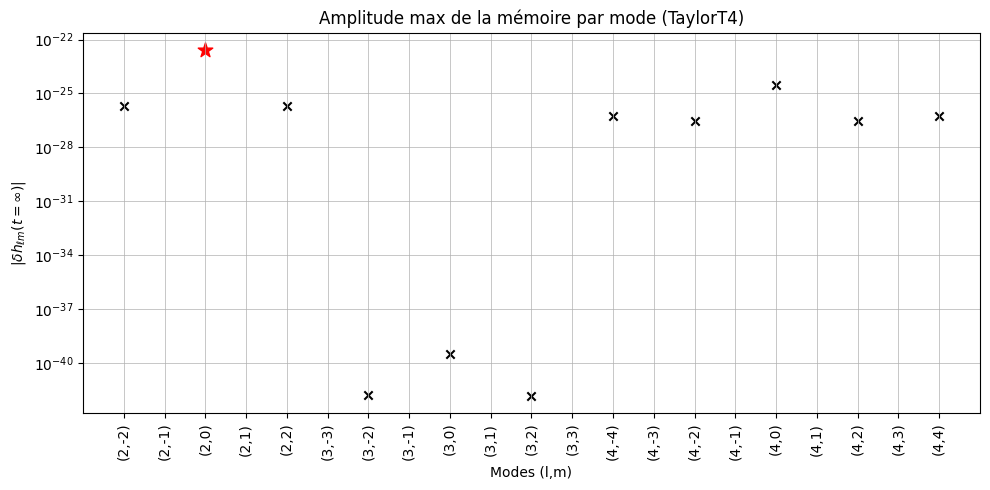

[np.float64(2.0026379993784892e-26), np.float64(0.0), np.float64(2.6032776202350345e-23), np.float64(0.0), np.float64(2.0026379993784892e-26), np.float64(0.0), np.float64(1.571698905942642e-42), np.float64(0.0), np.float64(3.065561294638601e-40), np.float64(0.0), np.float64(1.4968561008977546e-42), np.float64(0.0), np.float64(5.3920772088303855e-27), np.float64(0.0), np.float64(2.861440318260124e-27), np.float64(0.0), np.float64(2.8920459328020663e-25), np.float64(0.0), np.float64(2.8614403182601237e-27), np.float64(0.0), np.float64(5.3920772088303855e-27)]


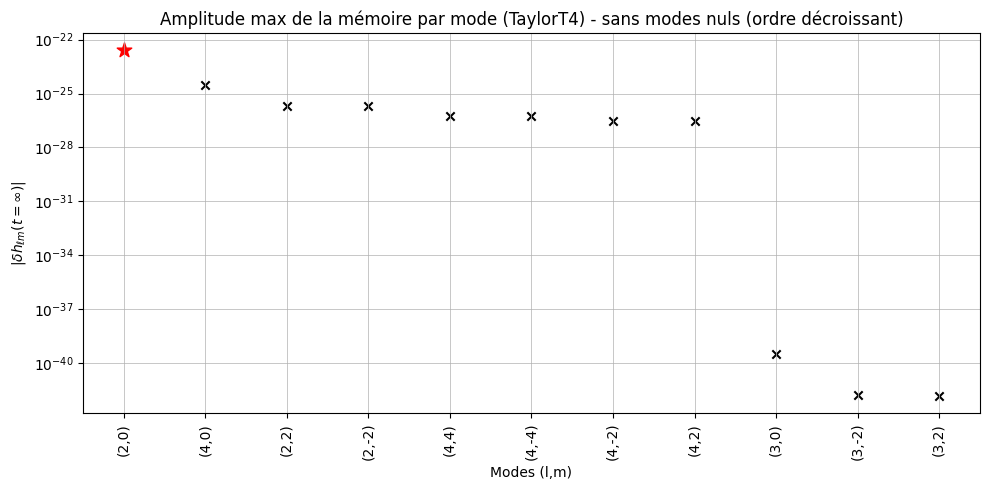

In [ ]:
# Extraire les max des effets mémoires pour chaque mode
modes = []
max_memory = []
for (l, m), mem in memory_modes.items():
    modes.append(f"({l},{m})")
    max_memory.append(np.max(np.abs(mem)))

# Scatter plot
plt.figure(figsize=(10, 5))
# Trouver l'indice de la plus grande valeur
max_idx = np.argmax(max_memory)

for i, (mode, mem) in enumerate(zip(modes, max_memory)):
    if i == max_idx:
        plt.scatter(mode, mem, color='r', marker='*', s=120)
    else:
        plt.scatter(mode, mem, color='black', marker='x')


plt.xticks(rotation=90)

plt.xlabel("Modes (l,m)")
plt.ylabel(r"$|\delta h_{\ell m}(t=\infty)|$")
plt.yscale('log')
plt.title("Amplitude max de la mémoire par mode (TaylorT4)")
plt.tight_layout()
plt.grid(True, which='both', linestyle='-', linewidth=0.5)
plt.show()
print(max_memory)
# Créer un masque pour les modes non nuls
mask_nonzero = np.array(max_memory) != 0
modes_nonzero = np.array(modes)[mask_nonzero]
max_memory_nonzero = np.array(max_memory)[mask_nonzero]

        
# Nouveau plot sans les modes nuls
plt.figure(figsize=(10, 5))
# Trier les modes et amplitudes par ordre décroissant d'amplitude
sorted_indices = np.argsort(max_memory_nonzero)[::-1]
modes_sorted = modes_nonzero[sorted_indices]
max_memory_sorted = max_memory_nonzero[sorted_indices]


for i, (mode, mem) in enumerate(zip(modes_sorted, max_memory_sorted)):
    if i == 0:
        plt.scatter(mode, mem, color='r', marker='*', s=120)
    else:
        plt.scatter(mode, mem, color='black', marker='x')

plt.xticks(rotation=90)
plt.xlabel("Modes (l,m)")
plt.ylabel(r"$|\delta h_{\ell m}(t=\infty)|$")
plt.yscale('log')
plt.grid(True, which='both', linestyle='-', linewidth=0.5)
plt.title("Amplitude max de la mémoire par mode (TaylorT4) - sans modes nuls (ordre décroissant)")
plt.tight_layout()
plt.show()

Heureusement le mode (2,0) domine pour l'effet mémoire comme mentionné dans plusieurs articles. Par ailleurs, on pourrait comparer les amplitudes des modes et non de l'effet mémoire induit par ces modes 

On peut comparer la mémoire calculé juste avec ``get_td_waveform_modes`` et avec la formule précédente

In [ ]:
# Mémoire pour le mode (2,0)
h20_mem = memory_modes.get((2,0), None)

# Calcul de la mémoire en sommant tous les modes - normalement négligeable par rapport à (2,0)
hmem_total = np.zeros_like(times)
for mem in memory_modes.values():
    hmem_total += mem
    

In [ ]:
# Calcul de l'effet mémoire sur base de la méthode simple du mode (2,2)
sys = "BNS"
distance = 100.0
deltaT = 1.0/4096
t_full, hplus_full, hcross_full = generate_waveform_extended(
            2.7, 0, sys, extension_time=0.2)
h22_old = generate_waveform_22(hplus_full, hcross_full)
hmem_old = compute_memory_corrected(deltaT, h22_old, distance)

# Idem mais on utilise le mode (2,2) de la méthode get_td_waveform_modes
h22_new = hlm_dict.get((2,2), (None, None))[0] - 1j*hlm_dict.get((2,2), (None, None))[1]
hmem_new = compute_memory_corrected(deltaT, h22_new, distance)

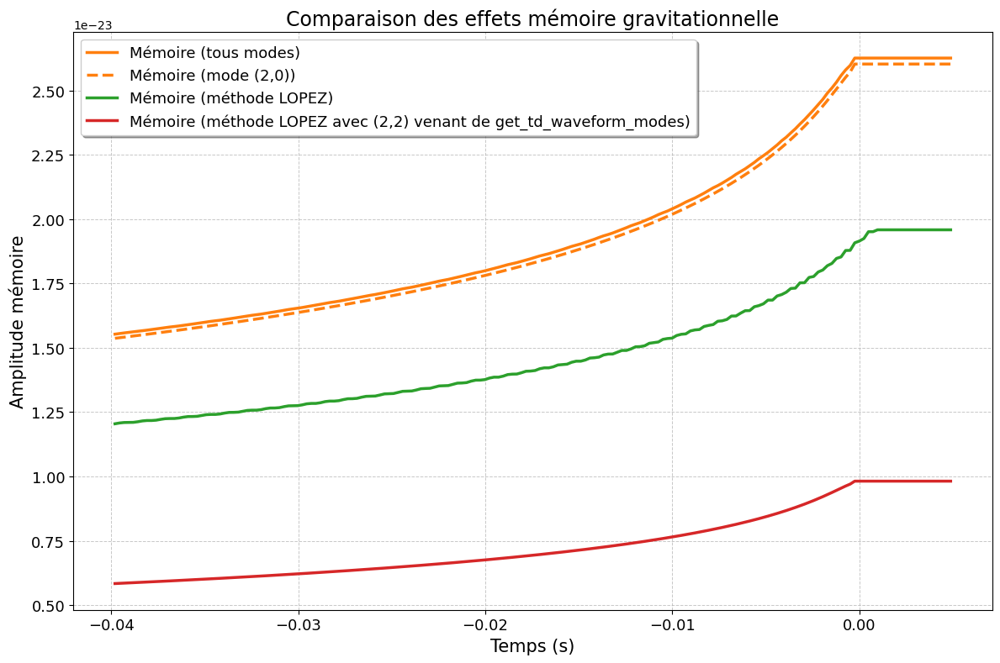

: 

In [ ]:
plt.figure(figsize=(12, 8))

# Masques pour la partie avant merger
mask = (times >= -0.04) & (times <= 0.005)
mask_full = (t_full >= -0.04) & (t_full <= 0.005)

# Tracé avec couleurs et styles améliorés
plt.plot(times[mask], hmem_total[mask], label="Mémoire (tous modes)", linestyle='-', color='#ff7f0e', linewidth=2.5)
plt.plot(times[mask], h20_mem[mask], label="Mémoire (mode (2,0))", linestyle='--', color='#ff7f0e', linewidth=2.5)
plt.plot(t_full[mask_full], hmem_old[mask_full], label="Mémoire (méthode LOPEZ)", linestyle='-', color='#2ca02c', linewidth=2.5)
plt.plot(times[mask], hmem_new[mask], label="Mémoire (méthode LOPEZ avec (2,2) venant de get_td_waveform_modes)", linestyle='-', color='#d62728', linewidth=2.5)

plt.legend(fontsize=13, loc='upper left', frameon=True, shadow=True)
plt.xlabel("Temps (s)", fontsize=15)
plt.ylabel("Amplitude mémoire", fontsize=15)
plt.title("Comparaison des effets mémoire gravitationnelle", fontsize=17)
plt.tick_params(axis='both', which='major', labelsize=13)
plt.grid(True, which='both', linestyle='--', linewidth=0.7, alpha=0.7)
plt.tight_layout()
plt.show()

Bien que les mémoires donnent des résultats proches, ils ne sont pas identiques et dépendant des méthodes de calculs. Lequel est le plus juste ? Il faudrait voir également le cas avec des approximants EOB (mais pas possible avec get_td_waveform_modes). Il faudrait aussi comparer avec gwmmemory 

2. Test de la librairy ``GWMEMORY``

In [ ]:
import gwmemory

In [ ]:
# Installons les différents approximants disponibles
approximants = [
    "SEOBNRv4", "NRsur7dq2", "MWM", "NRHybSur3dq8", "IMRPhenomD"]
for approx in approximants:
    %pip install approx

Defaulting to user installation because normal site-packages is not writeable
Note: you may need to restart the kernel to use updated packages.
Defaulting to user installation because normal site-packages is not writeable
Note: you may need to restart the kernel to use updated packages.
Defaulting to user installation because normal site-packages is not writeable
Note: you may need to restart the kernel to use updated packages.
Defaulting to user installation because normal site-packages is not writeable
Note: you may need to restart the kernel to use updated packages.
Defaulting to user installation because normal site-packages is not writeable
Note: you may need to restart the kernel to use updated packages.


/opt/pycbc/.local/lib/python3.11/site-packages/gwmemory/waveforms/mwm.py:132: RuntimeWarning: invalid value encountered in power
  rr = rm * (1 - TT / trr) ** (1 / 4)
/opt/pycbc/.local/lib/python3.11/site-packages/gwmemory/waveforms/mwm.py:150: ComplexWarning: Casting complex values to real discards the imaginary part
  h_MWM[post_merger] = 8 * np.pi * MM / rm + alt_sum_terms / (eta * MM)


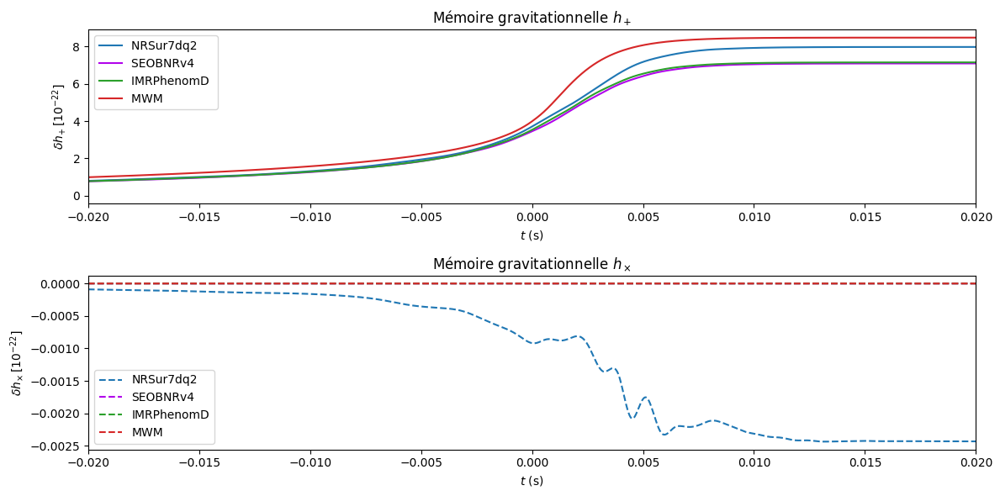

In [ ]:
fig = plt.figure(figsize=(12, 6))
ax = [fig.add_subplot(2, 1, 1), fig.add_subplot(2, 1, 2)]
# Paramètres communs
total_mass = 60          # Masse totale (M_sun)
distance = 100           # Distance (Mpc)
inc = np.pi / 2          # Inclinaison (face-on)
phase = 0                # Phase initiale
q = 1.0                  # Rapport de masse
spin_1 = [0.0, 0.0, 0.0] # Spin du premier objet
spin_2 = [0.0, 0.0, 0.0] # Spin du second objet
times = np.linspace(-0.08, 0.02, 10001)

models = ["NRSur7dq2", "SEOBNRv4", "IMRPhenomD", "MWM"]

colours = ['#1f77b4', "#b104eb", '#2ca02c', '#d62728']

for model, colour in zip(models, colours):
    parameters = dict(
        total_mass=total_mass, distance=distance, model=model,
        inc=inc, phase=phase, times=times, q=q,
        spin_1=spin_1, spin_2=spin_2
    )
    h_mem, times_out = gwmemory.time_domain_memory(**parameters)
    ax[0].plot(times_out, h_mem["plus"] * 1e22, color=colour, linestyle='-', label=f"{model} ")
    ax[1].plot(times_out, h_mem["cross"] * 1e22, color=colour, linestyle='--', label=f"{model}")

ax[0].set_xlabel("$t$ (s)")
ax[0].set_ylabel("$\delta h_{+} \\, [10^{-22}]$")
ax[0].set_title("Mémoire gravitationnelle $h_+$")
ax[0].set_xlim(-0.02, 0.02)
ax[0].legend(fontsize=10)


ax[1].set_xlabel("$t$ (s)")
ax[1].set_ylabel("$\delta h_{\\times} \\, [10^{-22}]$")
ax[1].set_title("Mémoire gravitationnelle $h_\\times$")
ax[1].set_xlim(-0.02, 0.02)
ax[1].legend(fontsize=10)

plt.tight_layout()
plt.show()

Chaque model donne une mémoire différente, il serait intéressant de comparer les modèles et voir lequel est le plus approprié pour la mémoire.

Importance de chaque mode pour l'effet mémoire

Erreur avec le modèle MWM: too many values to unpack (expected 2)


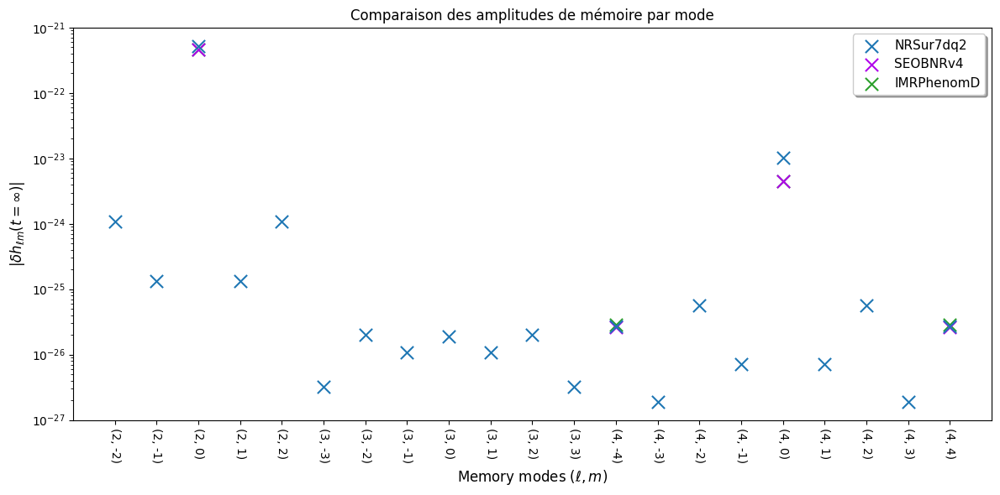

In [ ]:
fig = plt.figure(figsize=(12, 6))

# Configuration unique fixe
times = np.linspace(-0.08, 0.02, 10001)
parameters_base = dict(
    total_mass=60,           # Masse totale (M_sun)
    distance=400,           # Distance (Mpc)
    inc=np.pi / 2,          # Inclinaison (face-on)
    q=1.0,                  # Rapport de masse
    spin_1=[0.0, 0.0, 0.0], # Spin du premier objet
    spin_2=[0.0, 0.0, 0.0], # Spin du second objet
    times=times
)

# Modèles et couleurs
models = ["NRSur7dq2", "SEOBNRv4", "IMRPhenomD", "MWM"]
colours = ['#1f77b4', '#b104eb', '#2ca02c', '#d62728']


# Calcul et plot pour chaque modèle
for i, (model, colour) in enumerate(zip(models, colours)):
    parameters = parameters_base.copy()
    parameters["model"] = model
    
    try:
        h_mem, _ = gwmemory.time_domain_memory(**parameters)
        
        # Collecter les modes et amplitudes pour ce modèle
        mode_positions = []
        amplitudes = []
        mode_labels = []
        
        for ell, delta_m in h_mem:
            if ell <= 4:
                x_pos = ell**2 + delta_m + ell
                amplitude = abs(h_mem[(ell, delta_m)][-1])
                
                mode_positions.append(x_pos)
                amplitudes.append(amplitude)
                mode_labels.append(f"({ell},{delta_m})")
        
        # Scatter plot pour ce modèle
        plt.scatter(
            mode_positions, amplitudes,
            marker='x', s=120,
            color=colour,
            label=f"{model}",
            alpha=1,
            zorder=5 - i  # Pour superposer les modèles dans l'ordre
        )
                
    except Exception as e:
        print(f"Erreur avec le modèle {model}: {e}")

# Configuration du plot
plt.xlim(3, 5**2)
plt.xticks(range(4, 5**2, 1), rotation=270)

# Génération des étiquettes des modes
try:
    keys = [f"({ell}, {delta_m})" for ell, delta_m in gwmemory.harmonics.lmax_modes(4)]
    ax = plt.gca()
    ax.set_xticklabels(keys)
except:
    pass

plt.xlabel("Memory modes $(\ell, m)$", fontsize=12)
plt.ylabel("$|\delta h_{\ell m}(t=\infty)|$", fontsize=12)

plt.yscale("log")
plt.ylim(1e-27, 1e-21)

# Configuration de l'axe y
ax = plt.gca()
ax.set_yticks(np.logspace(-27, -21, 7))


# Légende et titre
plt.legend(fontsize=11, loc='upper right', frameon=True, shadow=True)
plt.title("Comparaison des amplitudes de mémoire par mode" )

plt.tight_layout()
plt.show()

On remarque encore une fois que le mode (2,0) domine largement l'effet mémoire pour chacun des modèles, on peut donc se contenter de ce mode pour approximer l'effet mémoire.

dict_keys(['plus', 'cross'])


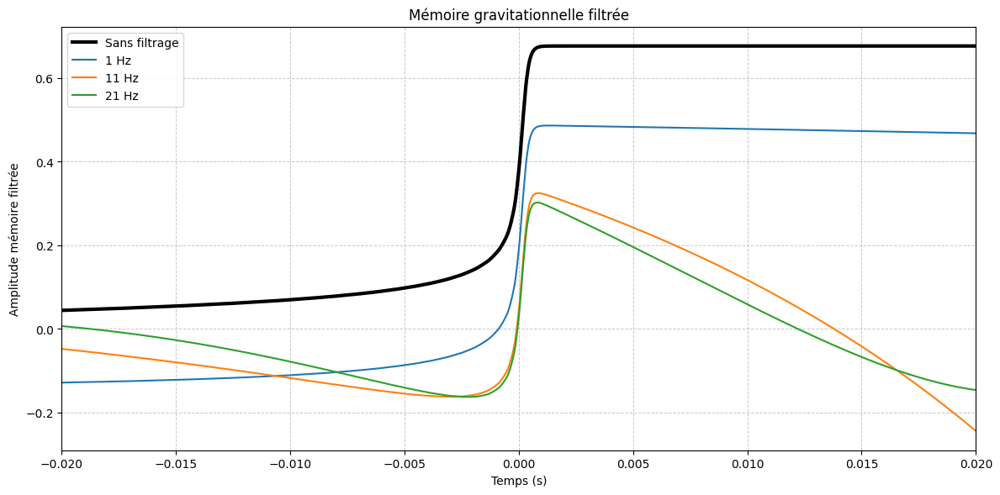

In [ ]:
parameters = dict(
    total_mass=5,           # Masse totale (M_sun)
    distance=100,           # Distance (Mpc)
    inc=np.pi / 2,          # Inclinaison (face-on)
    q=1.0,                  # Rapport de masse
    phase = 0,                # Phase initiale - sinon renvoit les modes
    spin_1=[0.0, 0.0, 0.0], # Spin du premier objet
    spin_2=[0.0, 0.0, 0.0], # Spin du second objet
    times=  np.linspace(-0.08, 0.02, 10001),
    model = "IMRPhenomD"
)

# Test appliquer un filtre passe bas pour la mémoire
from pycbc.filter import highpass, lowpass

plt.figure(figsize=(12, 6))
cutoff_freq_test = np.arange(1, 31, 10)
fs = 1.0 / (times[1] - times[0])  # Fréquence d'échantillonnage

# Appliquer le filtre à chaque mode et tracer
h_mem, t = gwmemory.time_domain_memory(**parameters)
print(h_mem.keys())
plt.plot(t, h_mem['plus'] * 1e22, label="Sans filtrage", color='black', linestyle='-', linewidth=3, zorder = 10)
# Conversion en TimeSeries pour le filtrage
mem_ts = TimeSeries(h_mem['plus'], delta_t=t[1] - t[0])
for cutoff in cutoff_freq_test:
    
    mem_filtered = highpass(mem_ts, cutoff)
    
    plt.plot(t, mem_filtered.numpy() * 1e22, label=f"{cutoff} Hz")

    plt.xlabel("Temps (s)")
    plt.ylabel("Amplitude mémoire filtrée")
    plt.title("Mémoire gravitationnelle filtrée")
    plt.xlim(-0.02, 0.02)
    plt.legend(fontsize=10)
    plt.grid(True, which='both', linestyle='--', linewidth=0.7, alpha =0.7)
    plt.tight_layout()
plt.show()

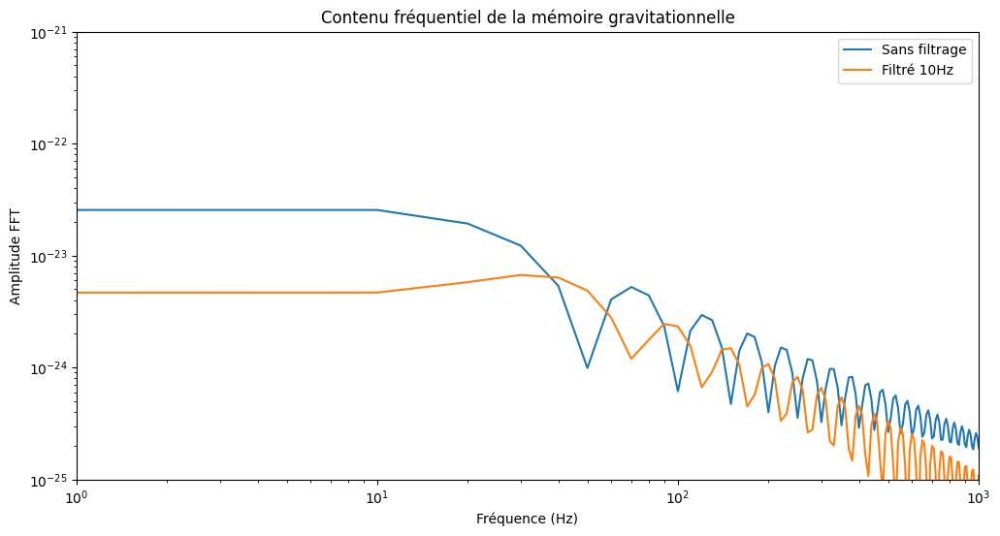

In [ ]:
# Appliquons une FFT pour voir le contenu fréquentiel
from scipy.fft import fft, fftfreq
plt.figure(figsize=(12, 6))

# Filtrage à 10Hz
mem_ts_10Hz = TimeSeries(h_mem['plus'], delta_t=t[1] - t[0])
mem_filtered_10Hz = highpass(mem_ts_10Hz, 10.0)
# Calcul de la FFT et plot 
for label, h_data in [("Sans filtrage", h_mem['plus']), ("Filtré 10Hz", mem_filtered_10Hz.numpy())]:
    N = len(t)
    T = t[1] - t[0]
    yf = fft(h_data)
    xf = fftfreq(N, T)[:N//2]
    plt.plot(xf, 2.0/N * np.abs(yf[0:N//2]), label=label)

plt.xscale('log')
plt.yscale('log')
plt.xlim(1, 1e3)
plt.ylim(1e-25, 1e-21)
plt.xlabel("Fréquence (Hz)")
plt.ylabel("Amplitude FFT")
plt.title("Contenu fréquentiel de la mémoire gravitationnelle")
plt.legend(fontsize=10)
plt.show()


Plot du spectrogramme de l'effet mémoire

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.gridspec import GridSpec
import gwmemory
from pycbc.filter import highpass, lowpass
from pycbc.types import TimeSeries as PyCBCTimeSeries
from gwpy.timeseries import TimeSeries as GWpyTimeSeries

def plot_memory_analysis(total_mass, model):
    """
    Analyse l'effet mémoire gravitationnelle avec spectrogramme
    Layout: 2x2 grid
    - Top row: Memory signals (raw left, filtered right)
    - Bottom row: Spectrograms (raw left, filtered right)
    
    Parameters:
    -----------
    model : str
        Modèle d'approximant à utiliser 
    total_mass : float
        Masse totale du système binaire (M_sun)
    """
    
    # Configuration des paramètres avec une grille temporelle adaptée
    times = np.linspace(-10, 10, 5001) # 10s avant et après le merger
    
    parameters = dict(
        total_mass=total_mass,
        distance=100,
        inc=np.pi / 2,
        q=1.0,
        phase=0,
        spin_1=[0.0, 0.0, 0.0],
        spin_2=[0.0, 0.0, 0.0],
        times=times,
        model=model
    )
    
    try:
        # Calcul de l'effet mémoire
        h_mem, t = gwmemory.time_domain_memory(**parameters)
        
        # Vérifications
        if len(h_mem['plus']) == 0 or np.all(h_mem['plus'] == 0):
            print(f"Erreur: L'effet mémoire est vide ou nul pour {model}")
            return
        
        # Conversion en GWpy TimeSeries pour les spectrogrammes
        dt = t[1] - t[0]
        mem_gwpy = GWpyTimeSeries(h_mem['plus'], dt=dt, t0=t[0])
        
        # Filtrage avec PyCBC 
        mem_pycbc = PyCBCTimeSeries(h_mem['plus'], delta_t=dt)
        mem_filtered_pycbc = highpass(mem_pycbc, 10.0)
        
        # Conversion du signal filtré en GWpy TimeSeries
        mem_filtered_gwpy = GWpyTimeSeries(mem_filtered_pycbc.numpy(), 
                                          dt=dt, t0=t[0])
        
        # Configuration de la figure 
        fig, axes = plt.subplots(2, 2, figsize=(14, 10), sharex='col', sharey=False)
        fig.suptitle(f' Memory analysis - {model} (M={total_mass} $M_\odot$)', 
                     y=0.98, fontsize=16, weight='bold')
        
        # Première lignes : Sinaux mémoires brut et filtré
        ax_raw = axes[0, 0]
        ax_raw.plot(t, h_mem['plus'] , 'b-', linewidth=2)
        ax_raw.set_xlabel('Time (s)')
        ax_raw.set_ylabel('Amplitude')
        ax_raw.set_title('Mémoire  (brute)')
        ax_raw.grid(True, alpha=0.3)
        textstr = (f'$M_{{tot}}$ = {total_mass} M$_\odot$\n'
                   f'$q$ = {parameters["q"]}\n'
                   f'Distance = {parameters["distance"]} Mpc')
        ax_raw.text(0.02, 0.98, textstr, transform=ax_raw.transAxes,
                    fontsize=10, verticalalignment='top',
                    bbox=dict(facecolor='white', alpha=0.8))
        
        ax_filt = axes[0, 1]
        ax_filt.plot(t, mem_filtered_pycbc.numpy() , 'r-', linewidth=2)
        ax_filt.set_xlabel('Time (s)')
        ax_filt.set_ylabel('Amplitude')
        ax_filt.set_title('Memory (filtered 10Hz)')
        ax_filt.grid(True, alpha=0.3)

        # 2 eme ligne : Spectrogrammes
        try:
            ax_spec_raw = axes[1, 0]
            specgram_raw = mem_gwpy.spectrogram2(fftlength=1.5, overlap=0, window=None)**(1/2.) # Sans overlap ni window pour simplifier (le signal est pur)
            clim_min_raw = np.percentile(specgram_raw.value, 5)
            clim_max_raw = np.percentile(specgram_raw.value, 99)
            im1 = ax_spec_raw.imshow(
                np.swapaxes(specgram_raw.value, 0, 1),
                aspect='auto',
                origin='lower',
                cmap='hot',
                extent=[
                    specgram_raw.times.value[0], 
                    t[-1],
                    specgram_raw.frequencies.value[0], 
                    specgram_raw.frequencies.value[-1]
                ],
                vmin=clim_min_raw,
                vmax=clim_max_raw
            )
            ax_spec_raw.set_yscale('log')
            ax_spec_raw.set_ylabel('Frequency (Hz)')
            ax_spec_raw.set_xlabel('Time (s)')
            ax_spec_raw.set_title('Spectrogram - Raw signal')
            ax_spec_raw.set_ylim(1, specgram_raw.frequencies.value[-1])
            
            ax_spec_filt = axes[1, 1]
            specgram_filt = mem_filtered_gwpy.spectrogram2(fftlength=1.5, overlap=0, window=None)**(1/2.)
            clim_min_filt = np.percentile(specgram_filt.value, 5)
            clim_max_filt = np.percentile(specgram_filt.value, 99)
            im2 = ax_spec_filt.imshow(
                np.swapaxes(specgram_filt.value, 0, 1),
                aspect='auto',
                origin='lower',
                cmap='hot',
                extent=[
                    specgram_filt.times.value[0], 
                    t[-1],
                    specgram_filt.frequencies.value[0], 
                    specgram_filt.frequencies.value[-1]
                ],
                vmin=clim_min_filt,
                vmax=clim_max_filt
            )
            ax_spec_filt.set_yscale('log')
            ax_spec_filt.set_ylabel('Fréquence (Hz)')
            ax_spec_filt.set_xlabel('Temps (s)')
            ax_spec_filt.set_title('Spectrogram - Filtered signal (10Hz)')
            ax_spec_filt.set_ylim(10, specgram_filt.frequencies.value[-1])
            
            # Colorbar commune pour les spectrogrammes
            ax_spec_filt.colorbar(clim = (clim_min_filt, clim_max_filt), label =r'Amplitude [$1/\sqrt{\mathrm{Hz}}$]')
                
        except Exception as spec_error:
            print(f"Erreur spectrogramme: {spec_error}")

        plt.tight_layout(rect=[0, 0, 0.97, 0.97])
        plt.show()
        
    except Exception as e:
        print(f"Erreur lors de l'analyse du modèle {model}: {e}")

# Exécution
plot_memory_analysis(total_mass = 2.5, model="NRSur7dq2")


NameError: name 'total_mass' is not defined

Remarque : 
- La mémoire calculée avec gwmemory est plus base que celle dans l'article (10**-27 contre 10**-23). Cela peut venir des paramètres utilisés (distance, masses, spins, inclinaison, ...) et du modèle ?
- On observe bien que la mémoire est un signal DC (basse fréquence) et qu'elle augmente au fur et à mesure de l'évolution du signal principal. 
- La mémoire est semblable à un burst (centré sur le merger) dans le spectrogramme

Piste d'amélioration et de réflexion :
- Injecter la mémoire dans un signal (ajout de la mémoire au signal principal) et voir si on peut la récupérer avec des méthodes de stacking
- Comparer les différentes méthodes de calcul de la mémoire (get_td_waveform_modes, gwmemory, autres ?) et voir sur le spectrogramme ?


---

## Test jolis plots pour illustrer la mémoire

In [ ]:
import matplotlib as plt
plt.rcParams["font.family"] = "serif"
plt.rcParams["font.serif"] = "STIXGeneral"
plt.rcParams["font.size"] = 20

/usr/local/lib/python3.11/site-packages/pykerr/qnm.py:2: UserWarning: pkg_resources is deprecated as an API. See https://setuptools.pypa.io/en/latest/pkg_resources.html. The pkg_resources package is slated for removal as early as 2025-11-30. Refrain from using this package or pin to Setuptools<81.
  import pkg_resources
/tmp/ipykernel_697/2623003787.py:172: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


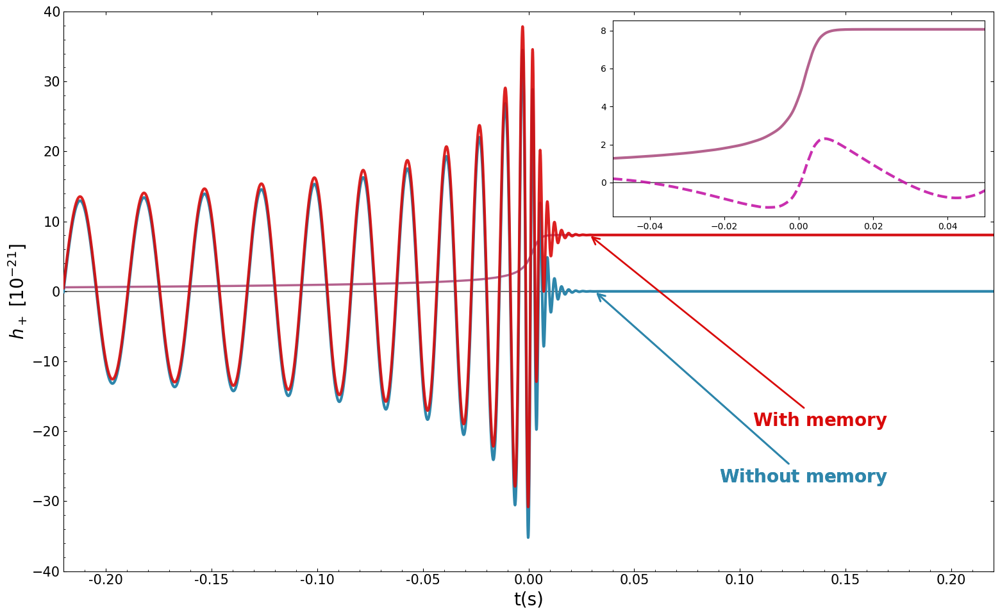

In [15]:
import numpy as np
import matplotlib.pyplot as plt
import gwmemory
from pycbc.waveform import get_td_waveform
from pycbc.filter import highpass
from pycbc.types import TimeSeries
from mpl_toolkits.axes_grid1.inset_locator import inset_axes
from matplotlib.ticker import MultipleLocator, AutoMinorLocator, FormatStrFormatter
from matplotlib.offsetbox import OffsetImage, AnnotationBbox

plt.rcParams["font.size"] = 20

def create_memory_comparison_plot():
    times = np.linspace(-1.0, 0.05, 10001)
    
    # Paramètres du cas à analyser
    params = {
        'total_mass': 60,
        'distance': 10,
        'inc': np.pi/2,  # face-on
        'q': 1.0,
        'phase': 0,
        'spin_1': [0.0, 0.0, 0.0],
        'spin_2': [0.0, 0.0, 0.0],
        'times': times,
        'model': "SEOBNRv4"
    }
    
    # Calcul mémoire avec gwmemory
    h_mem, t_mem = gwmemory.time_domain_memory(**params)
    
    # Calcul signal oscillatoire avec PyCBC
    hp_osc, hc_osc = get_td_waveform(
        approximant="SEOBNRv4",
        mass1=params['total_mass']/2.0,
        mass2=params['total_mass']/2.0,
        spin1z=params['spin_1'][2],
        spin2z=params['spin_2'][2],
        delta_t=times[1] - times[0],
        f_lower=20.0,
        distance=params['distance'],
        inclination=np.pi/2
    )
    
    # Interpolation du signal oscillatoire
    t_osc = hp_osc.sample_times.numpy()
    # Interpolation du signal oscillatoire
    hp_osc_interp = np.interp(t_mem, t_osc, hp_osc.numpy())
    # Ajout d'une constante nulle à la fin pour prolonger le signal jusqu'à 0.30 s
    if t_mem[-1] < 0.30:
        t_mem = np.append(t_mem, 0.30)
        hp_osc_interp = np.append(hp_osc_interp, 0.0)
        h_mem['plus'] = np.append(h_mem['plus'], h_mem['plus'][-1])

    
    # Signal total (oscillatoire + mémoire)
    h_total = hp_osc_interp + h_mem['plus']
    
    # Signal mémoire filtré à 10 Hz
    mem_ts = TimeSeries(h_mem['plus'], delta_t=times[1] - times[0])
    h_mem_filtered = highpass(mem_ts, 10.0).numpy()
    
    # === CRÉATION DE LA FIGURE PRINCIPALE ===
    fig, ax = plt.subplots(1, 1, figsize=(16, 10))
    
    # Plot du signal oscillatoire seul
    ax.plot(t_mem, hp_osc_interp * 1e21, 
            color='#2E86AB', linestyle='-', linewidth=3, 
            label='Oscillatory waveform', zorder=3)
    
    # Plot du signal total (oscillatoire + mémoire)
    ax.plot(t_mem, h_total * 1e21, 
            color='#D90A0A', linestyle='-', linewidth=3, alpha=0.9,
            label='Oscillatory + Memory', zorder=4)
    # Plot de la mémoire :
    ax.plot(t_mem, h_mem['plus'] * 1e21,
               color='#A23B72', linestyle='-', linewidth=2.5,
               label='Memory (raw)', alpha=0.8)
    
    # Lignes de référence
    ax.axhline(y=0, color='black', linestyle='-', linewidth=1.1, alpha=0.7, zorder=1)
    
    
    # Configuration de l'axe principal
    ax.set_ylabel(r'$h_+$ [$10^{-21}$]', fontsize=20)
    ax.set_xlabel('t(s)', fontsize=20)
    ax.set_xlim(-0.22, 0.22)
    ax.set_ylim(-40, 40)
    
    # Configuration des ticks
    ax.tick_params(top=True, right=True, axis='both', which='major', labelsize=15, direction='in')
    ax.tick_params(axis='both', which='minor', labelsize=12, direction='in')
    ax.set_xticks(np.arange(-0.2, 0.2, 0.05))
    ax.yaxis.set_minor_locator(AutoMinorLocator(2))
    ax.xaxis.set_major_locator(MultipleLocator(0.05))
    ax.xaxis.set_minor_locator(AutoMinorLocator(5))
    ax.xaxis.set_major_formatter(FormatStrFormatter('%.2f'))
    ax.minorticks_on()
    
    
    # === CRÉATION DE L'INSERT EN HAUT À DROITE ===
    axins = inset_axes(ax, width="40%", height="35%", loc='upper right',
                       bbox_to_anchor=(0, 0, 1, 1), bbox_transform=ax.transAxes)
    
    # Plot de la mémoire brute dans l'insert
    axins.plot(t_mem, h_mem['plus'] * 1e21,
               color='#A23B72', linestyle='-', linewidth=3,
               label='Memory signal', alpha=0.8)
    
    # Plot de la mémoire filtrée dans l'insert
    axins.plot(t_mem, h_mem_filtered * 1e21,
               color="#C318A6", linestyle='--', linewidth=3,
               label='Memory (10Hz filtered)', alpha=0.9)
    
    # Configuration de l'insert
    axins.set_xlim(-0.05, 0.05)
    #axins.set_xlabel('t(s)', fontsize=12)
    #axins.set_ylabel(r'$h_{\mathrm{mem}}$ [$10^{-21}$]', fontsize=12)
    axins.tick_params(labelsize=10)

    
    # Ligne de référence dans l'insert
    axins.axhline(y=0, color='black', linestyle='-', linewidth=1.1, alpha=0.7, zorder=-1)
    
    # Add arrows pointing to the "Oscillatory + Memory" and "Oscillatory waveform" signals

    idx_mem = np.argmax(np.abs(h_total)) +300
    idx_osc = np.argmax(np.abs(hp_osc_interp)) + 300

    # Arrow origin (bottom right of the main plot)
    arrow_origin_x = ax.get_xlim()[1] - 0.05
    arrow_origin_y = ax.get_ylim()[0] + 20

    # Arrow to "Oscillatory + Memory"
    ax.annotate(
        r'$\mathbf{With\ memory}$',
        xy=(t_mem[idx_mem], h_total[idx_mem] * 1e21),
        xytext=(arrow_origin_x, arrow_origin_y),
        arrowprops=dict(facecolor='#D90A0A', edgecolor='#D90A0A', arrowstyle='->', lw=2),
        color='#D90A0A',
        fontsize=20,
        ha='right',
        va='bottom'
    )

    # Arrow to "Oscillatory waveform"
    ax.annotate(
        r'$\mathbf{Without\ memory}$',
        xy=(t_mem[idx_osc], hp_osc_interp[idx_osc] * 1e21),
        xytext=(arrow_origin_x, arrow_origin_y - 8),
        arrowprops=dict(facecolor='#2E86AB', edgecolor='#2E86AB', arrowstyle='->', lw=2),
        color='#2E86AB',
        fontsize=20,
        ha='right',
        va='bottom'
    )
    # Arrow to "Oscillatory waveform"
    ax.annotate(
        r'$\mathbf{Without\ memory}$',
        xy=(t_mem[idx_osc], hp_osc_interp[idx_osc] * 1e21),
        xytext=(arrow_origin_x, arrow_origin_y - 8),
        arrowprops=dict(facecolor='#2E86AB', edgecolor='#2E86AB', arrowstyle='->', lw=2),
        color='#2E86AB',
        fontsize=20,
        ha='right',
        va='bottom'
    )
    
  
    
    
    plt.tight_layout()
    plt.show()

create_memory_comparison_plot()

# Memory vs Mass Ratio, Distance, Inclination in frequency domain

On modifie un peu la fonction qui génère la mémoire pour pourvoir modif certain paramètres (mass ration, distance, inclinaiso)

In [5]:
# fonction qui renvoit lambda_1 lambda_2 pour une valeur de lambda_tilde donnée et un rapport de masse q
def Lambdas_for_approx(lam_tilde, q):
    lambda1 = lam_tilde * (13/16) * (1 + q)**5 / (q**4 * (q+12) + q**5 * (1+12*q))
    lambda2 = lambda1 * q**5
    return lambda1, lambda2
    

In [5]:
# Modification des fonctions pour inclure directement inclination + fonction pour directement calc la mémoire
def generate_waveform_22(hp, hc, inclination):
    """
    Génère le mode (2,2) à partir de hp et hc, avec inclination passée en paramètre.
    """
    h22 = (hp - 1.j*hc) / sYlm(-2, 2, 2, inclination, np.pi/2)
    return h22

def compute_memory_corrected(deltaT, h22, distance, inclination):
    """
    Mémoire non-linéaire avec normalisation physique correcte, avec inclination passée en paramètre.
    """
    dt = deltaT
    hdot = np.gradient(h22, dt)
    hdot_c = np.conjugate(hdot)
    integrand = hdot * hdot_c
    cumint = np.cumsum(integrand) * dt
    prefactor = (distance * 10**6 * PC_SI / C_SI) * (np.sin(inclination))**2 * (17 + np.cos(inclination)**2) / (192 * np.pi)
    hmem = prefactor * cumint 
    return np.real(hmem)
# Nouvelle fonction qui renvoit la mémoire sans devoir appeler les fonctions intermédiaires
def generate_h_mem(mtot, lam_tilde, q, distance, inclination, extension_time=0.2, approximant="IMRPhenomPv2_NRTidal"):
    # Calcul des masses individuelles
    m1 = mtot / (1 + q)
    m2 = q * m1
    lambda1, lambda2 = Lambdas_for_approx(lam_tilde, q)
    print(f'Value of lambda1: {lambda1}, lambda2: {lambda2} for q={q} and lam_tilde={lam_tilde}')
    # Génération de la waveform avec PyCBC
    hp, hc = get_td_waveform(
        approximant=approximant,
        mass1=m1, mass2=m2,
        lambda1=lambda1, lambda2=lambda2,
        delta_t=deltaT,
        f_lower=20.,
        distance=distance, 
        inclination=inclination, 
        tc=0.0,
        spin_1z=0.0, spin_2z=0.0, 
        spin_1y=0.0, spin_2y=0.0,
        spin_1x=0.0, spin_2x=0.0, 
        phase = 0.0
    )
    # Conversion en arrays numpy
    hp_orig = hp.numpy()
    hc_orig = hc.numpy()
    t_orig = hp.sample_times.numpy()
    
    # Alignement manuel : merger à t=0
    amplitude = np.abs(hp_orig)
    merger_idx = np.argmax(amplitude)
    merger_time = t_orig[merger_idx]
    t_aligned = t_orig - merger_time
    
    # Extension post-merger
    n_extension = int(extension_time / deltaT)
    hp_extension = np.zeros(n_extension)
    hc_extension = np.zeros(n_extension)
    t_extension = np.arange(1, n_extension + 1) * deltaT + t_aligned[-1]
    
    # Concaténation
    t_full = np.concatenate([t_aligned, t_extension])
    hp_full = np.concatenate([hp_orig, hp_extension])
    hc_full = np.concatenate([hc_orig, hc_extension])
    
    # Calcul du mode (2,2) avec inclination
    h22 = generate_waveform_22(hp_full, hc_full, inclination)
    
    # Calcul de la mémoire avec inclination
    hmem = compute_memory_corrected(deltaT, h22, distance, inclination)
    
    return t_full, hmem

In [18]:
help(get_td_waveform)

Help on function get_td_waveform in module pycbc.waveform.waveform:

get_td_waveform(template=None, **kwargs)
    Return the plus and cross polarizations of a time domain waveform.
    
    Parameters
    ----------
    template: object
        An object that has attached properties. This can be used to subsitute
        for keyword arguments. A common example would be a row in an xml table.
    mass1 : {None, float}
        The mass of the first component object in the binary (in solar masses).
    mass2 : {None, float}
        The mass of the second component object in the binary (in solar masses).
    spin1x : {0.0, float}
        The x component of the first binary component's dimensionless spin.
    spin1y : {0.0, float}
        The y component of the first binary component's dimensionless spin.
    spin1z : {0.0, float}
        The z component of the first binary component's dimensionless spin.
    spin2x : {0.0, float}
        The x component of the second binary component's dim

Value of lambda1: 0.0, lambda2: 0.0 for q=1.0 and lam_tilde=0
Value of lambda1: 100.0, lambda2: 100.0 for q=1.0 and lam_tilde=100
Value of lambda1: 200.0, lambda2: 200.0 for q=1.0 and lam_tilde=200
Value of lambda1: 600.0, lambda2: 600.0 for q=1.0 and lam_tilde=600
Value of lambda1: 1000.0, lambda2: 1000.0 for q=1.0 and lam_tilde=1000
Value of lambda1: 1400.0, lambda2: 1400.0 for q=1.0 and lam_tilde=1400
Value of lambda1: 1800.0, lambda2: 1800.0 for q=1.0 and lam_tilde=1800


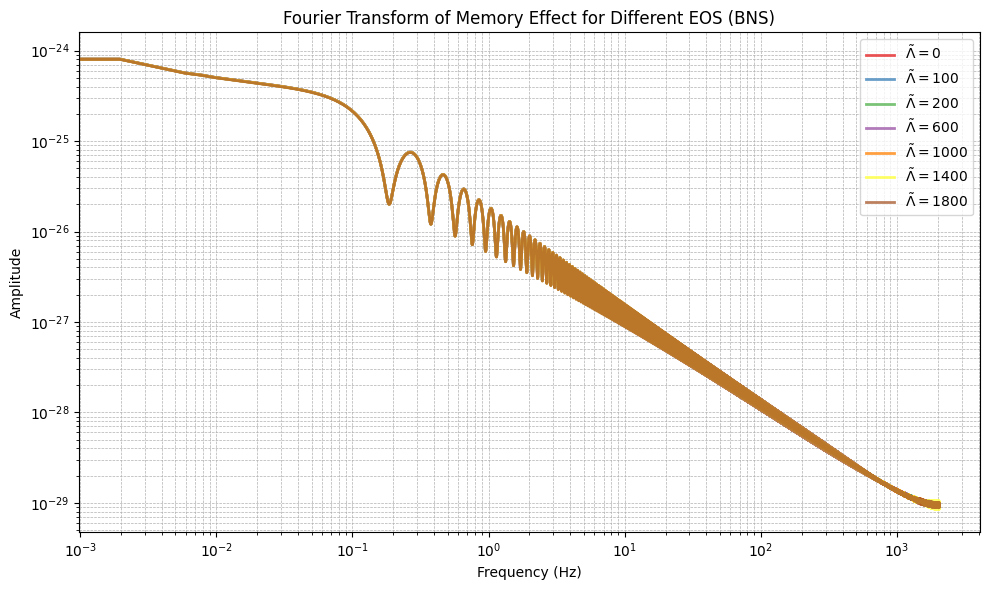

In [6]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.fft import fft, fftfreq

# Paramètres fixes
deltaT = 1.0 / 4096
distance = 100.0
inclination = np.pi / 2
Mtot = 2.7  # Masse totale fixe

# Valeurs de lambda_tilde pour différentes EOS
lambda_values = [0, 100, 200, 600, 1000, 1400, 1800]

cmap = plt.cm.Set1  
colors = [cmap(i) for i in range(len(lambda_values))]

# Figure pour le plot
fig, ax = plt.subplots(figsize=(10, 6))

for i, lam in enumerate(lambda_values):
    # Générer la waveform étendue
    _, hmem = generate_h_mem(
        mtot=Mtot,
        lam_tilde=lam,
        q=1.0,
        distance=distance,
        inclination=inclination,
        extension_time=0.2,
        approximant="IMRPhenomPv2_NRTidal"
    )
    
    # Calcul de la FFT
    N = len(hmem)
    T = deltaT
    yf = fft(hmem)
    xf = fftfreq(N, T)[:N//2] # On ne garde que les fréquences positives 
    amplitude = 2.0 / N * np.abs(yf[0:N//2])
    
    ax.plot(xf, amplitude, color=colors[i], label=rf'$\tilde{{\Lambda}} = {lam}$', linewidth=2, alpha=0.75)

ax.set_xscale('log')
ax.set_yscale('log')
ax.set_xlabel('Frequency (Hz)')
ax.set_ylabel('Amplitude')
ax.set_title('Fourier Transform of Memory Effect for Different EOS (BNS)')
ax.legend()
ax.grid(True, which='both', linestyle='--', linewidth=0.5)

plt.tight_layout()
plt.show()

A première vue, pas d'impact de la déformabilité tidal sur la mémoire - d'où le plot de Lopez et.al sur le pic mémoire

Calcul peak mémoire:   0%|          | 0/40 [00:00<?, ?it/s]

Calcul peak mémoire: 100%|██████████| 40/40 [2:32:04<00:00, 228.11s/it]  


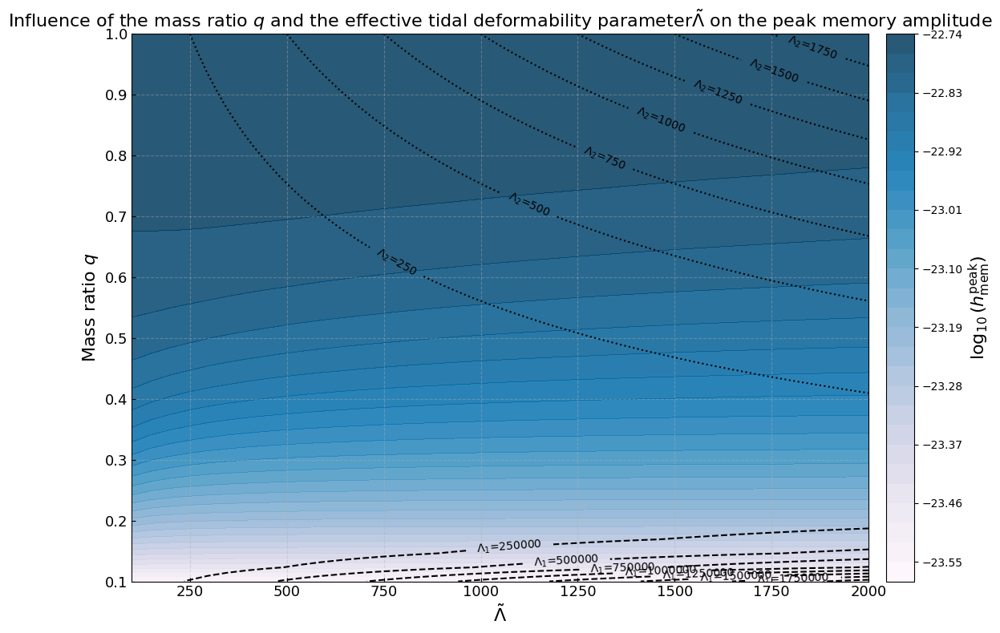

In [ ]:
# Plot comparant lambda_1 lambda_2 mass ratio et amplitude mémoire max 
from matplotlib import cm
from tqdm import tqdm  

# Mémoire + renvoit lambda1 lambda2
def generate_h_mem_L(mtot, lam_tilde, q, distance, inclination, extension_time=0.2, approximant="IMRPhenomPv2_NRTidal"):
    m1 = mtot / (1 + q)
    m2 = q * m1
    lambda1, lambda2 = Lambdas_for_approx(lam_tilde, q)
    hp, hc = get_td_waveform(
        approximant=approximant,
        mass1=m1, mass2=m2,
        lambda1=lambda1, lambda2=lambda2,
        delta_t=deltaT,
        f_lower=20.,
        distance=distance, 
        inclination=inclination, 
        tc=0.0
    )
    hp_orig = hp.numpy()
    hc_orig = hc.numpy()
    t_orig = hp.sample_times.numpy()
    amplitude = np.abs(hp_orig)
    merger_idx = np.argmax(amplitude)
    merger_time = t_orig[merger_idx]
    t_aligned = t_orig - merger_time
    n_extension = int(extension_time / deltaT)
    hp_extension = np.zeros(n_extension)
    hc_extension = np.zeros(n_extension)
    t_extension = np.arange(1, n_extension + 1) * deltaT + t_aligned[-1]
    t_full = np.concatenate([t_aligned, t_extension])
    hp_full = np.concatenate([hp_orig, hp_extension])
    hc_full = np.concatenate([hc_orig, hc_extension])
    h22 = generate_waveform_22(hp_full, hc_full, inclination)
    hmem = compute_memory_corrected(deltaT, h22, distance, inclination)
    return t_full, hmem, lambda1, lambda2

#  Paramètres du plot 
deltaT = 1.0 / 4096
mtot = 2.5
distance = 100.0
inclination = np.pi/2
lam_tilde_array = np.linspace(100, 2000, 40)
q_array = np.linspace(0.1, 1.0, 40)

LAM, Q = np.meshgrid(lam_tilde_array, q_array)
peak_mem = np.zeros_like(LAM)
lambda1_grid = np.zeros_like(LAM)
lambda2_grid = np.zeros_like(LAM)

for i in tqdm(range(LAM.shape[0]), desc="Calcul peak mémoire"):
    for j in range(LAM.shape[1]):
        lam = LAM[i, j]
        q = Q[i, j]
        try:
            _, hmem, lambda1, lambda2 = generate_h_mem_L(mtot, lam, q, distance, inclination, extension_time=0.2)
            peak_mem[i, j] = np.max(np.abs(hmem))
            lambda1_grid[i, j] = lambda1
            lambda2_grid[i, j] = lambda2
        except Exception:
            peak_mem[i, j] = np.nan
            lambda1_grid[i, j] = np.nan
            lambda2_grid[i, j] = np.nan

# Save données dans fichier text pour éviter de recompiler 
np.savetxt('memory_peak_data.txt', 
           np.column_stack((LAM.ravel(), Q.ravel(), peak_mem.ravel(), lambda1_grid.ravel(), lambda2_grid.ravel())), 
           header='Lambda_tilde  q  peak_memory  lambda1  lambda2')



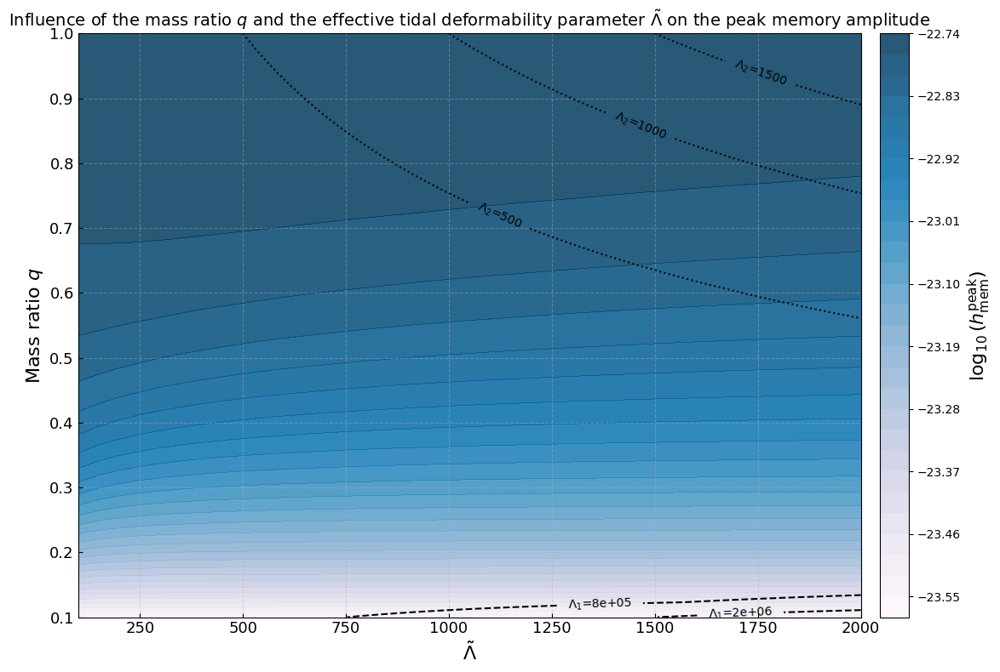

In [15]:
from matplotlib import cm
# Personnalisation du plot 
data = np.loadtxt('memory_peak_data.txt')
LAM = data[:, 0].reshape(40, 40)
Q = data[:, 1].reshape(40, 40)
peak_mem = data[:, 2].reshape(40, 40)
lambda1_grid = data[:, 3].reshape(40, 40)
lambda2_grid = data[:, 4].reshape(40, 40)
fig, ax = plt.subplots(figsize=(12, 8))
cmap = cm.PuBu
contour = ax.contourf(LAM, Q, np.log10(peak_mem), levels=30, cmap=cmap, alpha=0.85)
cbar = plt.colorbar(contour, ax=ax, pad=0.02)
cbar.set_label(r'$\log_{10}(h^{\mathrm{peak}}_{\mathrm{mem}})$', fontsize=16)

# Contours pour lambda1 et lambda2
cs1 = ax.contour(LAM, Q, lambda1_grid, levels=2, colors='k', linewidths=1.5, linestyles='dashed') 
cs2 = ax.contour(LAM, Q, lambda2_grid, levels=3, colors='k', linewidths=1.5, linestyles='dotted')
ax.clabel(cs1, inline=True, fontsize=10, fmt='$\Lambda_1$=%.0e')
ax.clabel(cs2, inline=True, fontsize=10, fmt='$\Lambda_2$=%.0f')

ax.set_xlabel(r'$\tilde{\Lambda}$', fontsize=16)
ax.set_ylabel(r'Mass ratio $q$', fontsize=16)
ax.set_title(r'Influence of the mass ratio $q$ and the effective tidal deformability parameter $\tilde{\Lambda}$ on the peak memory amplitude', fontsize=14)
ax.tick_params(axis='both', which='major', labelsize=13, direction='in')
ax.grid(True, linestyle='--', alpha=0.4)

plt.tight_layout()
plt.show()



Value of lambda1: 255426.64670658694, lambda2: 4.3256726905889495 for q=0.1111111111111111 and lam_tilde=350
Value of lambda1: 24395.70922851564, lambda2: 13.22059129388305 for q=0.2222222222222222 and lam_tilde=350
Value of lambda1: 6933.333333333333, lambda2: 28.532235939643336 for q=0.3333333333333333 and lam_tilde=350
Value of lambda1: 3003.255277467006, lambda2: 52.08104123907625 for q=0.4444444444444444 and lam_tilde=350
Value of lambda1: 1617.0259030837003, lambda2: 85.57648642883986 for q=0.5555555555555556 and lam_tilde=350
Value of lambda1: 991.8212890625, lambda2: 130.61021090534976 for q=0.6666666666666666 and lam_tilde=350
Value of lambda1: 662.9550854403788, lambda2: 188.69559384572875 for q=0.7777777777777777 and lam_tilde=350
Value of lambda1: 470.9097516005206, lambda2: 261.3214574412074 for q=0.8888888888888888 and lam_tilde=350
Value of lambda1: 350.0, lambda2: 350.0 for q=1.0 and lam_tilde=350


/tmp/ipykernel_887/1555688268.py:48: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  plt.tight_layout()
/usr/local/lib/python3.11/site-packages/IPython/core/pylabtools.py:170: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.canvas.print_figure(bytes_io, **kw)


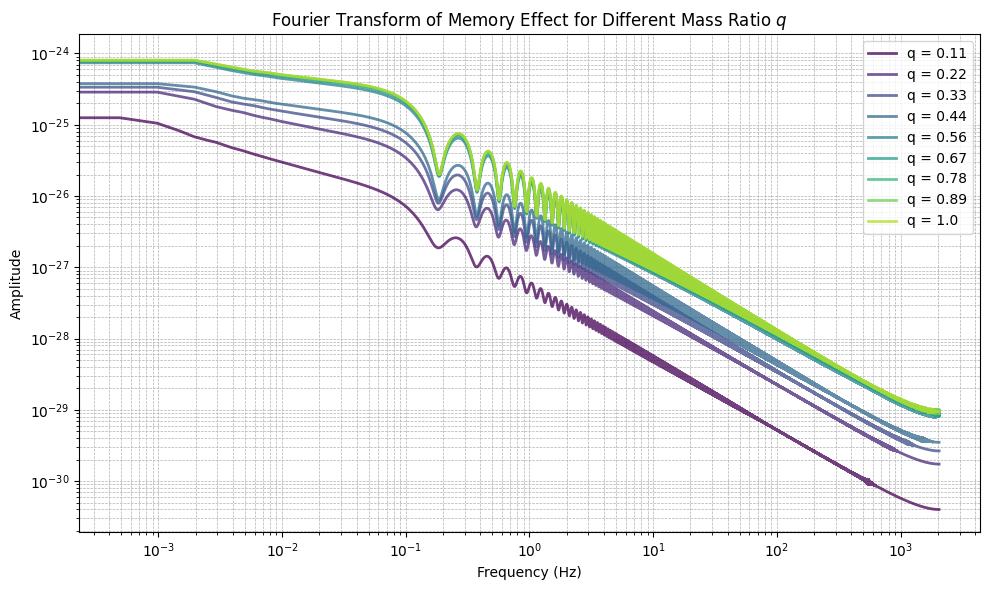

In [ ]:
# Paramètres fixes
deltaT = 1.0 / 4096
distance = 100.0
inclination = np.pi / 2
Mtot = 2.7  # Masse totale fixe

q_array = np.linspace(0.0, 1.0, 10)[1:]  # Éviter q=0 pour éviter les divisions par zéro

cmap = plt.cm.viridis 
colors = [cmap(i / len(q_array)) for i in range(len(q_array))]

# Figure pour le plot
fig, ax = plt.subplots(figsize=(10, 6))

for i,q in enumerate(q_array):

    _, hmem = generate_h_mem(
        mtot=Mtot,
        lam_tilde=350,  # Valeur fixe de lambda_tilde
        q=q,
        distance=distance,
        inclination=inclination,
        extension_time=0.2,
        approximant="IMRPhenomPv2_NRTidal"
    )
    N = len(hmem)
    T = deltaT
    yf = fft(hmem)
    xf = fftfreq(N, T)[:N//2]
    amplitude = 2.0 / N * np.abs(yf[0:N//2])
    
    ax.plot(xf, amplitude, color=colors[i], label=f'q = {np.round(q, 2)}', linewidth=2, alpha=0.75)

ax.set_xscale('log')
ax.set_yscale('log')
ax.set_xlabel('Frequency (Hz)')
ax.set_ylabel('Amplitude')
ax.set_title(rf'Fourier Transform of Memory Effect for Different Mass Ratio $q$')
ax.legend()
ax.grid(True, which='both', linestyle='--', linewidth=0.5)

plt.tight_layout()
plt.show()
        
 

On a bien que la mémoire est plus importante pour des mass ratio élevé

Value of lambda1: 350.0, lambda2: 350.0 for q=1.0 and lam_tilde=350
Value of lambda1: 350.0, lambda2: 350.0 for q=1.0 and lam_tilde=350
Value of lambda1: 350.0, lambda2: 350.0 for q=1.0 and lam_tilde=350
Value of lambda1: 350.0, lambda2: 350.0 for q=1.0 and lam_tilde=350
Value of lambda1: 350.0, lambda2: 350.0 for q=1.0 and lam_tilde=350


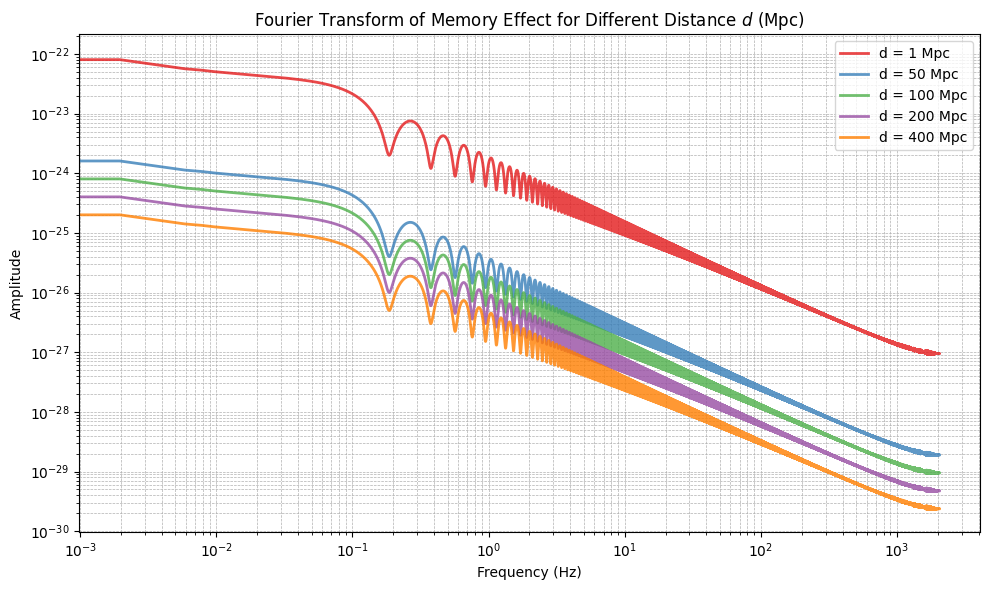

In [ ]:
# Paramètres fixes
deltaT = 1.0 / 4096
q= 1.0
inclination = np.pi / 2
Mtot = 2.7  # Masse totale fixe

cmap = plt.cm.Set1  
distances = [1, 50, 100, 200, 400]  # Distances en Mpc
colors = [cmap(i) for i in range(len(distances))]

fig, ax = plt.subplots(figsize=(10, 6))

for i,dist in enumerate(distances):

    _, hmem = generate_h_mem(
        mtot=Mtot,
        lam_tilde=350,  # Valeur fixe de lambda_tilde
        q=q,
        distance=dist,
        inclination=inclination,
        extension_time=0.2,
        approximant="IMRPhenomPv2_NRTidal"
    )
    
    # Calcul de la FFT
    N = len(hmem)
    T = deltaT
    yf = fft(hmem)
    xf = fftfreq(N, T)[:N//2]
    amplitude = 2.0 / N * np.abs(yf[0:N//2])
    
    ax.plot(xf, amplitude, color=colors[i], label=f'd = {dist} Mpc', linewidth=2, alpha=0.8)


ax.set_xscale('log')
ax.set_yscale('log')
ax.set_xlabel('Frequency (Hz)')
ax.set_ylabel('Amplitude')
ax.set_title(rf'Fourier Transform of Memory Effect for Different Distance $d$ (Mpc)')
ax.legend()
ax.grid(True, which='both', linestyle='--', linewidth=0.5)

plt.tight_layout()
plt.show()
        
 

Idem impact de la distance sur la mémoire

Value of lambda1: 350.0, lambda2: 350.0 for q=1.0 and lam_tilde=350
Value of lambda1: 350.0, lambda2: 350.0 for q=1.0 and lam_tilde=350
Value of lambda1: 350.0, lambda2: 350.0 for q=1.0 and lam_tilde=350


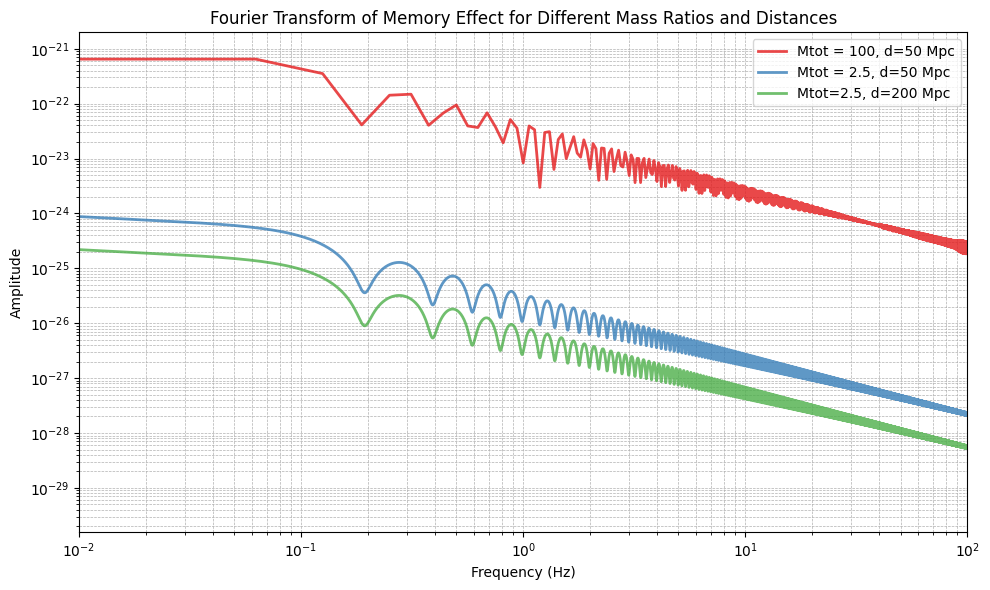

In [40]:
# Plot de 3 cas : impact de la distance et mass ratio
deltaT = 1.0 / 4096
inclination = np.pi / 2
Mtot = 2.7  # Masse totale fixe
cases = [
    {'Mtot' : 100.0, 'q': 1.0, 'distance': 50, 'label': 'Mtot = 100, d=50 Mpc'},
    {'Mtot' : 2.5,'q': 1.0, 'distance': 50, 'label': 'Mtot = 2.5, d=50 Mpc'},
    {'Mtot' : 2.5,'q': 1.0, 'distance': 200, 'label': 'Mtot=2.5, d=200 Mpc'}
]
cmap = plt.cm.Set1
colors = [cmap(i) for i in range(len(cases))]
fig, ax = plt.subplots(figsize=(10, 6))
for i, case in enumerate(cases):
    _, hmem = generate_h_mem(
        mtot=case['Mtot'],
        lam_tilde=350,
        q=1.0,
        distance=case['distance'],
        inclination=inclination,
        extension_time=0.0,
        approximant="IMRPhenomPv2_NRTidal"
    )
    N = len(hmem)
    T = deltaT
    yf = fft(hmem)
    xf = fftfreq(N, T)[:N//2]
    amplitude = 2.0 / N * np.abs(yf[0:N//2])
    ax.plot(xf, amplitude, color=colors[i], label=case['label'], linewidth=2, alpha=0.8)
ax.set_xscale('log')
ax.set_yscale('log')
ax.set_xlabel('Frequency (Hz)')
ax.set_ylabel('Amplitude')
ax.set_title(r'Fourier Transform of Memory Effect for Different Mass Ratios and Distances')
ax.legend()
ax.grid(True, which='both', linestyle='--', linewidth=0.5)
ax.set_xlim(1e-2, 1e2)
plt.tight_layout()
plt.show()

Test de plots plus compacts

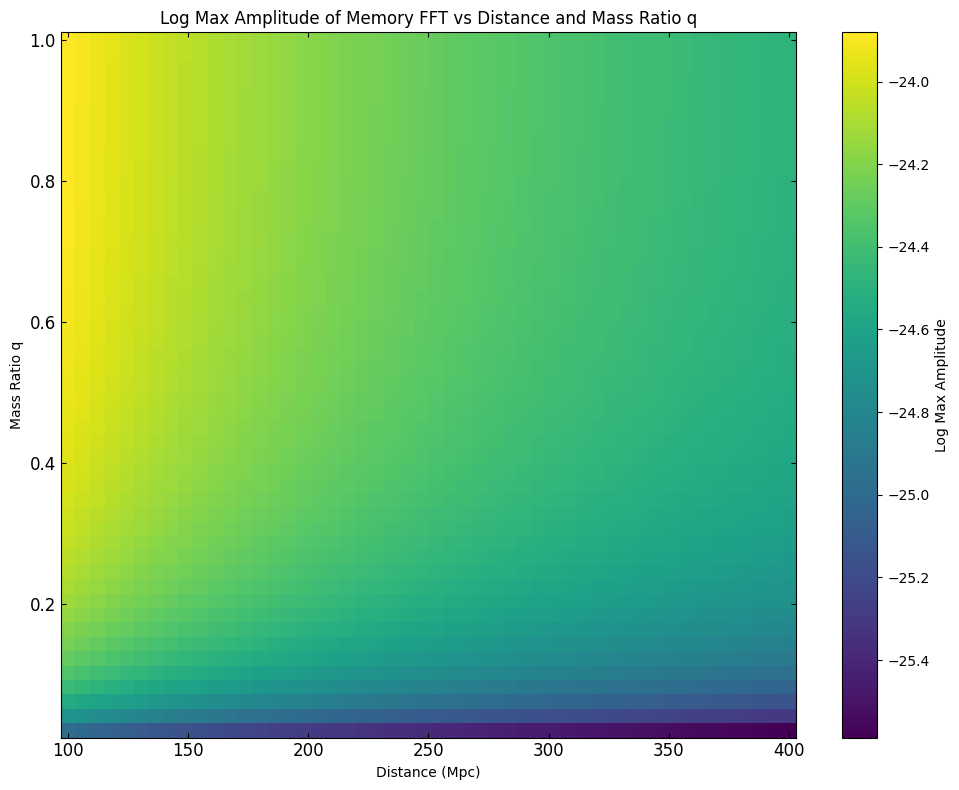

In [ ]:
# Paramètres fixes
deltaT = 1.0 / 4096
inclination = np.pi / 2
Mtot = 2.7
lam_tilde = 350  # Fixé pour cet exemple

# Grilles de paramètres
q_values = np.linspace(0.0, 1.0, 50 )[1:]  # Éviter q=0
distance_values = np.linspace(100.0, 400.0, 50)

max_amplitudes = np.zeros((len(q_values), len(distance_values)))

for i, q in enumerate(q_values):
    for j, dist in enumerate(distance_values):
        # Générer la waveform
        _, hmem = generate_h_mem(
            mtot=Mtot,
            lam_tilde=lam_tilde,
            q=q,
            distance=dist,
            inclination=inclination,
            extension_time=0.2,
            approximant="IMRPhenomPv2_NRTidal"
        )
        
        # Calcul de la FFT
        N = len(hmem)
        T = deltaT
        yf = fft(hmem)
        xf = fftfreq(N, T)[:N//2]
        amplitude = 2.0 / N * np.abs(yf[0:N//2])
        
        max_amplitudes[i, j] = np.max(amplitude)

fig, ax = plt.subplots(figsize=(10, 8))

X, Y = np.meshgrid(distance_values, q_values)
Z = np.log10(max_amplitudes)  # Log pour meilleure visualisation

c = ax.pcolormesh(X, Y, Z, shading='auto', cmap='viridis')
ax.set_xlabel('Distance (Mpc)')
ax.set_ylabel('Mass Ratio q')
ax.set_title('Log Max Amplitude of Memory FFT vs Distance and Mass Ratio q')

cbar = plt.colorbar(c, ax=ax)
cbar.set_label('Log Max Amplitude')
ax.tick_params(top=True, right=True, axis='both', which='major', labelsize=12, direction='in')

plt.tight_layout()
plt.show()

Value of lambda1: 350.0, lambda2: 350.0 for q=1 and lam_tilde=350
Value of lambda1: 350.0, lambda2: 350.0 for q=1 and lam_tilde=350
Value of lambda1: 350.0, lambda2: 350.0 for q=1 and lam_tilde=350
Value of lambda1: 350.0, lambda2: 350.0 for q=1 and lam_tilde=350
Value of lambda1: 350.0, lambda2: 350.0 for q=1 and lam_tilde=350
Value of lambda1: 350.0, lambda2: 350.0 for q=1 and lam_tilde=350
Value of lambda1: 350.0, lambda2: 350.0 for q=1 and lam_tilde=350
Value of lambda1: 350.0, lambda2: 350.0 for q=1 and lam_tilde=350
Value of lambda1: 350.0, lambda2: 350.0 for q=1 and lam_tilde=350
Value of lambda1: 350.0, lambda2: 350.0 for q=1 and lam_tilde=350
Value of lambda1: 350.0, lambda2: 350.0 for q=1 and lam_tilde=350
Value of lambda1: 350.0, lambda2: 350.0 for q=1 and lam_tilde=350
Value of lambda1: 350.0, lambda2: 350.0 for q=1 and lam_tilde=350
Value of lambda1: 350.0, lambda2: 350.0 for q=1 and lam_tilde=350
Value of lambda1: 350.0, lambda2: 350.0 for q=1 and lam_tilde=350
Value of l

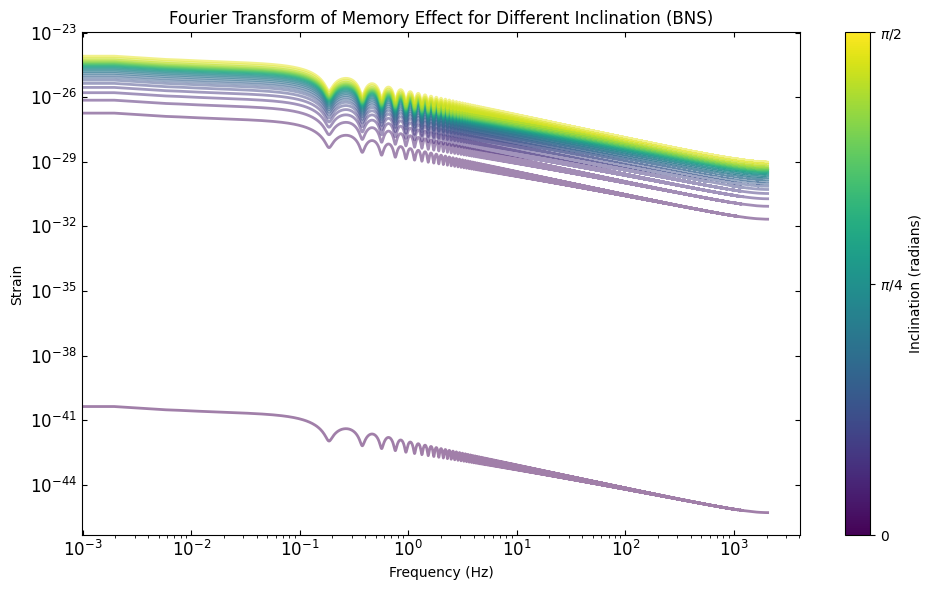

In [ ]:
# Paramètres fixes
deltaT = 1.0 / 4096
distance = 100.0
Mtot = 2.7  # Masse totale fixe
q= 1 # Mass ratio fixe
eps = 1e-8
incl_array = np.linspace(0+eps, np.pi /2, 25) 
cmap = plt.cm.viridis 
colors = [cmap(i / len(incl_array)) for i in range(len(incl_array))]

# Figure pour le plot
fig, ax = plt.subplots(figsize=(10, 6))

for i,incl in enumerate(incl_array):

    _,hmem = generate_h_mem(Mtot, 350, q, distance, incl, extension_time=0.2)

    N = len(hmem)
    T = deltaT
    yf = fft(hmem)
    xf = fftfreq(N, T)[:N//2]
    amplitude = 2.0 / N * np.abs(yf[0:N//2])
    ax.plot(xf, amplitude, color=colors[i], label=f'i = {np.round(incl, 2)}', linewidth=2, alpha=0.5)

ax.set_xscale('log')
ax.set_yscale('log')
ax.set_xlabel('Frequency (Hz)')
ax.set_ylabel('Strain')
ax.set_title(rf'Fourier Transform of Memory Effect for Different Inclination (BNS)')


norm = plt.Normalize(vmin=0, vmax=np.pi/2)
sm = cm.ScalarMappable(cmap=cmap, norm=norm)
sm.set_array([])
cbar = plt.colorbar(sm, ax=ax)
cbar.set_label('Inclination (radians)')
cbar.set_ticks([0, np.pi/4, np.pi/2])
cbar.set_ticklabels(['0', r'$\pi/4$', r'$\pi/2$'])

ax.tick_params(top=True, right=True, axis='both', which='major', labelsize=12, direction='in')
plt.tight_layout()
plt.show()

Très petite valeur de la mémoire car on a une inclinaison de 10**-8. Après on voit bien que la mémoire est maximisé pour une inclinaison edge-on

# Reproduction plot figure 2 de l'article Lopez

Value of lambda1: 1116.5210939746835, lambda2: 231.46281629041997 for q=0.73 and lam_tilde=500
Value of lambda1: 1563.129531564557, lambda2: 324.04794280658797 for q=0.73 and lam_tilde=700
Value of lambda1: 2210.711766069873, lambda2: 458.29637625503153 for q=0.73 and lam_tilde=990
Value of lambda1: 3014.606953731646, lambda2: 624.9496039841341 for q=0.73 and lam_tilde=1350
Value of lambda1: 4131.128047706329, lambda2: 856.4124202745539 for q=0.73 and lam_tilde=1850
Value of lambda1: 880.6925608699481, lambda2: 288.58533834586467 for q=0.8 and lam_tilde=500
Value of lambda1: 1232.9695852179275, lambda2: 404.0194736842106 for q=0.8 and lam_tilde=700
Value of lambda1: 1743.7712705224974, lambda2: 571.398969924812 for q=0.8 and lam_tilde=990
Value of lambda1: 2377.86991434886, lambda2: 779.1804135338347 for q=0.8 and lam_tilde=1350
Value of lambda1: 3258.5624752188082, lambda2: 1067.7657518796993 for q=0.8 and lam_tilde=1850
Value of lambda1: 500.0, lambda2: 500.0 for q=1.0 and lam_tilde=

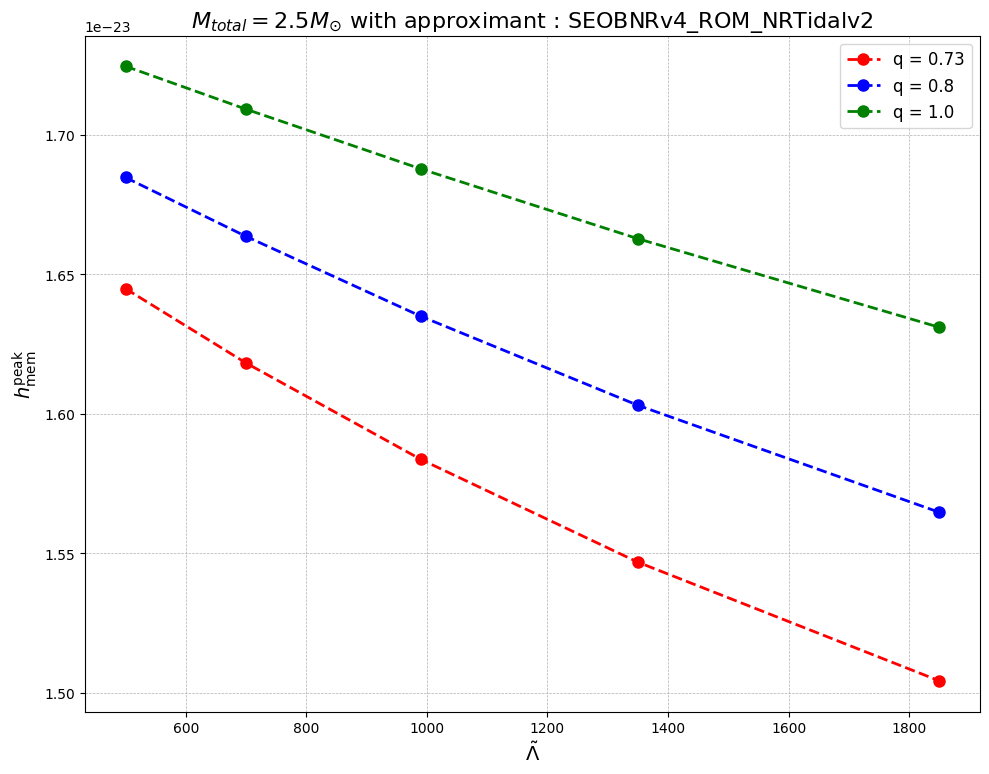

Value of lambda1: 1116.5210939746835, lambda2: 231.46281629041997 for q=0.73 and lam_tilde=500
Value of lambda1: 1563.129531564557, lambda2: 324.04794280658797 for q=0.73 and lam_tilde=700
Value of lambda1: 2210.711766069873, lambda2: 458.29637625503153 for q=0.73 and lam_tilde=990
Value of lambda1: 3014.606953731646, lambda2: 624.9496039841341 for q=0.73 and lam_tilde=1350
Value of lambda1: 4131.128047706329, lambda2: 856.4124202745539 for q=0.73 and lam_tilde=1850
Value of lambda1: 880.6925608699481, lambda2: 288.58533834586467 for q=0.8 and lam_tilde=500
Value of lambda1: 1232.9695852179275, lambda2: 404.0194736842106 for q=0.8 and lam_tilde=700
Value of lambda1: 1743.7712705224974, lambda2: 571.398969924812 for q=0.8 and lam_tilde=990
Value of lambda1: 2377.86991434886, lambda2: 779.1804135338347 for q=0.8 and lam_tilde=1350
Value of lambda1: 3258.5624752188082, lambda2: 1067.7657518796993 for q=0.8 and lam_tilde=1850
Value of lambda1: 500.0, lambda2: 500.0 for q=1.0 and lam_tilde=

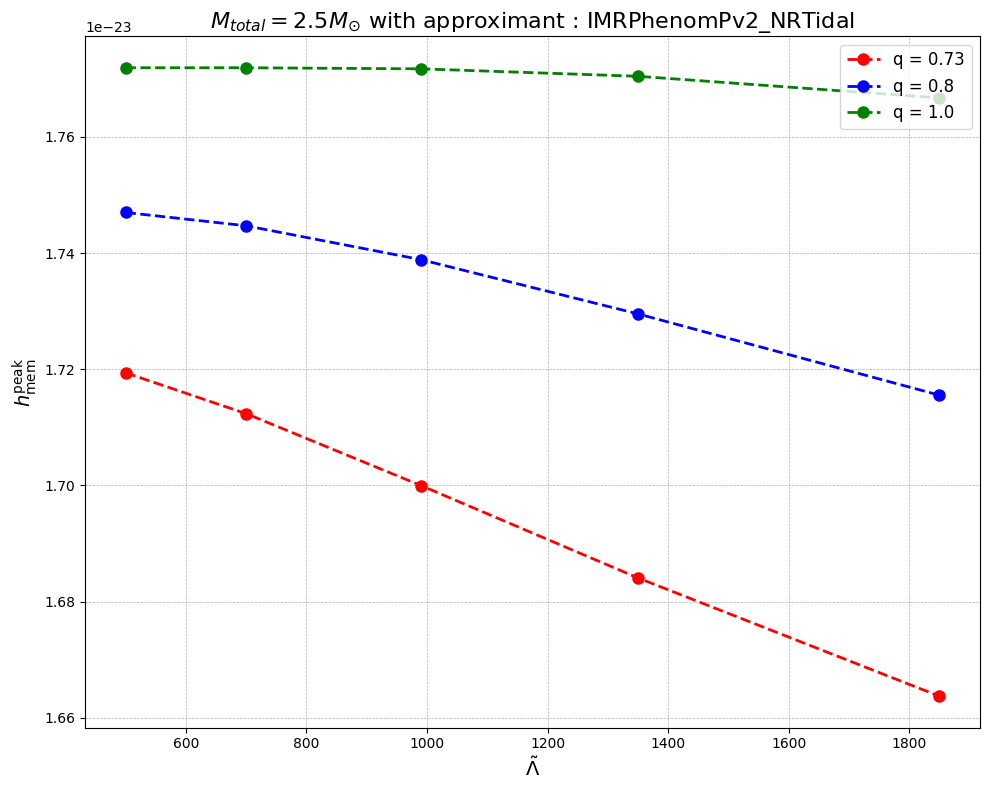

Value of lambda1: 1116.5210939746835, lambda2: 231.46281629041997 for q=0.73 and lam_tilde=500
Value of lambda1: 1563.129531564557, lambda2: 324.04794280658797 for q=0.73 and lam_tilde=700
Value of lambda1: 2210.711766069873, lambda2: 458.29637625503153 for q=0.73 and lam_tilde=990
Value of lambda1: 3014.606953731646, lambda2: 624.9496039841341 for q=0.73 and lam_tilde=1350
Value of lambda1: 4131.128047706329, lambda2: 856.4124202745539 for q=0.73 and lam_tilde=1850
Value of lambda1: 880.6925608699481, lambda2: 288.58533834586467 for q=0.8 and lam_tilde=500
Value of lambda1: 1232.9695852179275, lambda2: 404.0194736842106 for q=0.8 and lam_tilde=700
Value of lambda1: 1743.7712705224974, lambda2: 571.398969924812 for q=0.8 and lam_tilde=990
Value of lambda1: 2377.86991434886, lambda2: 779.1804135338347 for q=0.8 and lam_tilde=1350
Value of lambda1: 3258.5624752188082, lambda2: 1067.7657518796993 for q=0.8 and lam_tilde=1850
Value of lambda1: 500.0, lambda2: 500.0 for q=1.0 and lam_tilde=

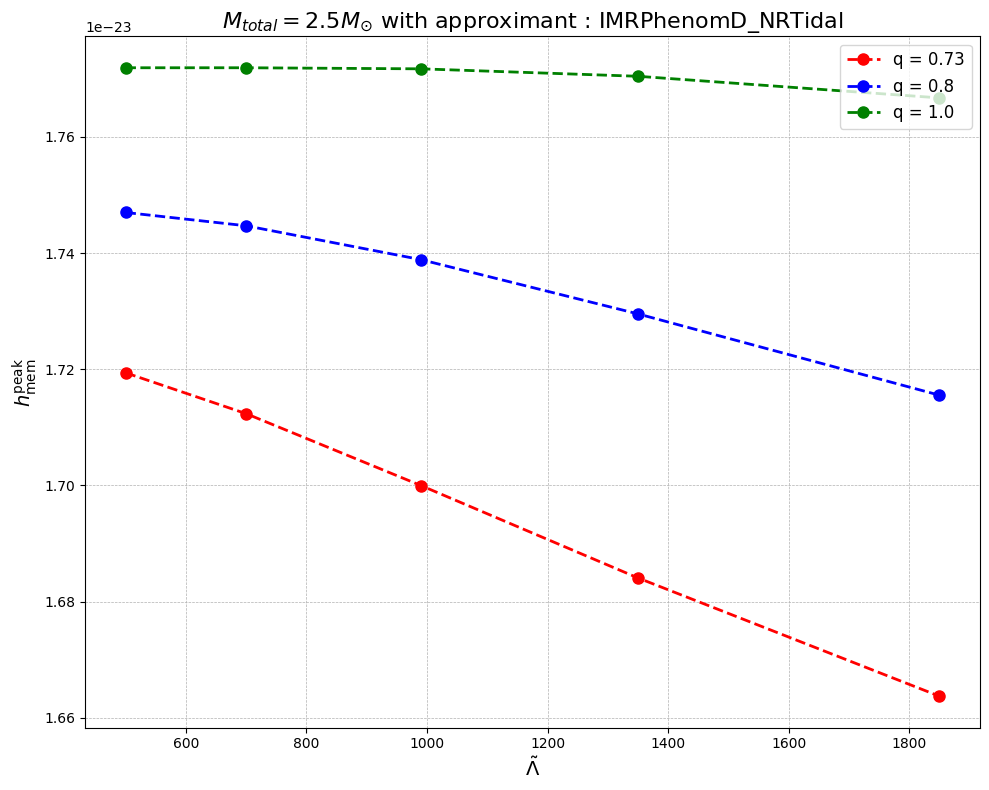

Value of lambda1: 1116.5210939746835, lambda2: 231.46281629041997 for q=0.73 and lam_tilde=500
Value of lambda1: 1563.129531564557, lambda2: 324.04794280658797 for q=0.73 and lam_tilde=700
Value of lambda1: 2210.711766069873, lambda2: 458.29637625503153 for q=0.73 and lam_tilde=990
Value of lambda1: 3014.606953731646, lambda2: 624.9496039841341 for q=0.73 and lam_tilde=1350
Value of lambda1: 4131.128047706329, lambda2: 856.4124202745539 for q=0.73 and lam_tilde=1850
Value of lambda1: 880.6925608699481, lambda2: 288.58533834586467 for q=0.8 and lam_tilde=500
Value of lambda1: 1232.9695852179275, lambda2: 404.0194736842106 for q=0.8 and lam_tilde=700
Value of lambda1: 1743.7712705224974, lambda2: 571.398969924812 for q=0.8 and lam_tilde=990
Value of lambda1: 2377.86991434886, lambda2: 779.1804135338347 for q=0.8 and lam_tilde=1350
Value of lambda1: 3258.5624752188082, lambda2: 1067.7657518796993 for q=0.8 and lam_tilde=1850
Value of lambda1: 500.0, lambda2: 500.0 for q=1.0 and lam_tilde=

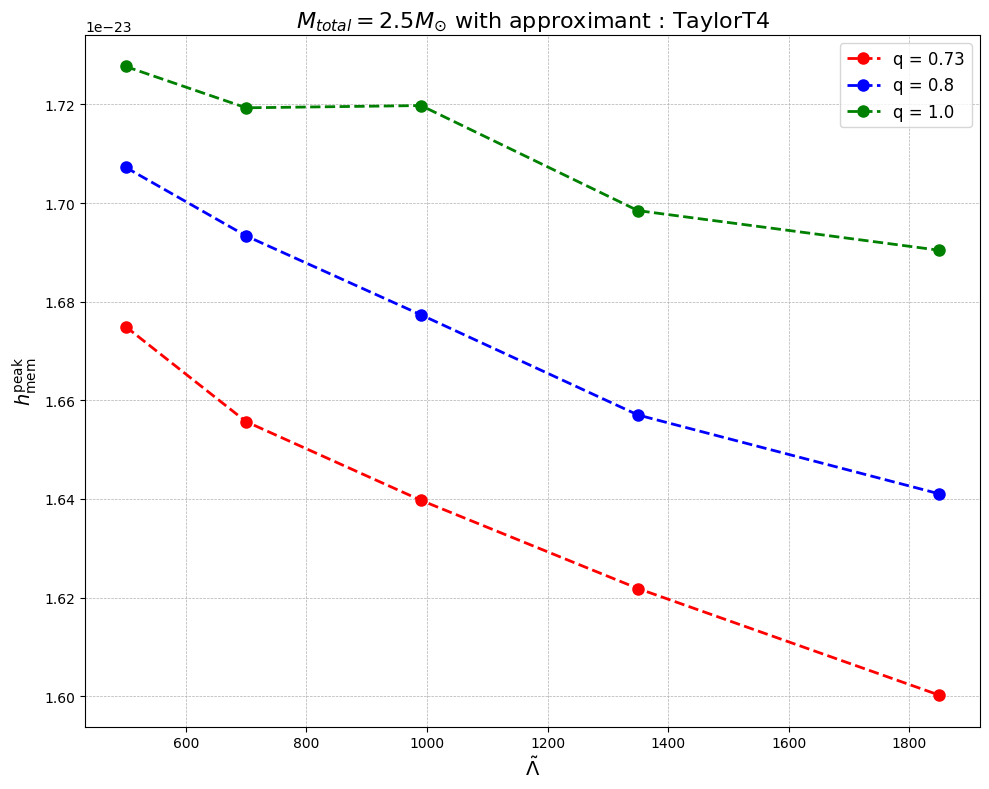

Value of lambda1: 1116.5210939746835, lambda2: 231.46281629041997 for q=0.73 and lam_tilde=500
Value of lambda1: 1563.129531564557, lambda2: 324.04794280658797 for q=0.73 and lam_tilde=700
Value of lambda1: 2210.711766069873, lambda2: 458.29637625503153 for q=0.73 and lam_tilde=990
Value of lambda1: 3014.606953731646, lambda2: 624.9496039841341 for q=0.73 and lam_tilde=1350
Value of lambda1: 4131.128047706329, lambda2: 856.4124202745539 for q=0.73 and lam_tilde=1850
Value of lambda1: 880.6925608699481, lambda2: 288.58533834586467 for q=0.8 and lam_tilde=500
Value of lambda1: 1232.9695852179275, lambda2: 404.0194736842106 for q=0.8 and lam_tilde=700
Value of lambda1: 1743.7712705224974, lambda2: 571.398969924812 for q=0.8 and lam_tilde=990
Value of lambda1: 2377.86991434886, lambda2: 779.1804135338347 for q=0.8 and lam_tilde=1350
Value of lambda1: 3258.5624752188082, lambda2: 1067.7657518796993 for q=0.8 and lam_tilde=1850
Value of lambda1: 500.0, lambda2: 500.0 for q=1.0 and lam_tilde=

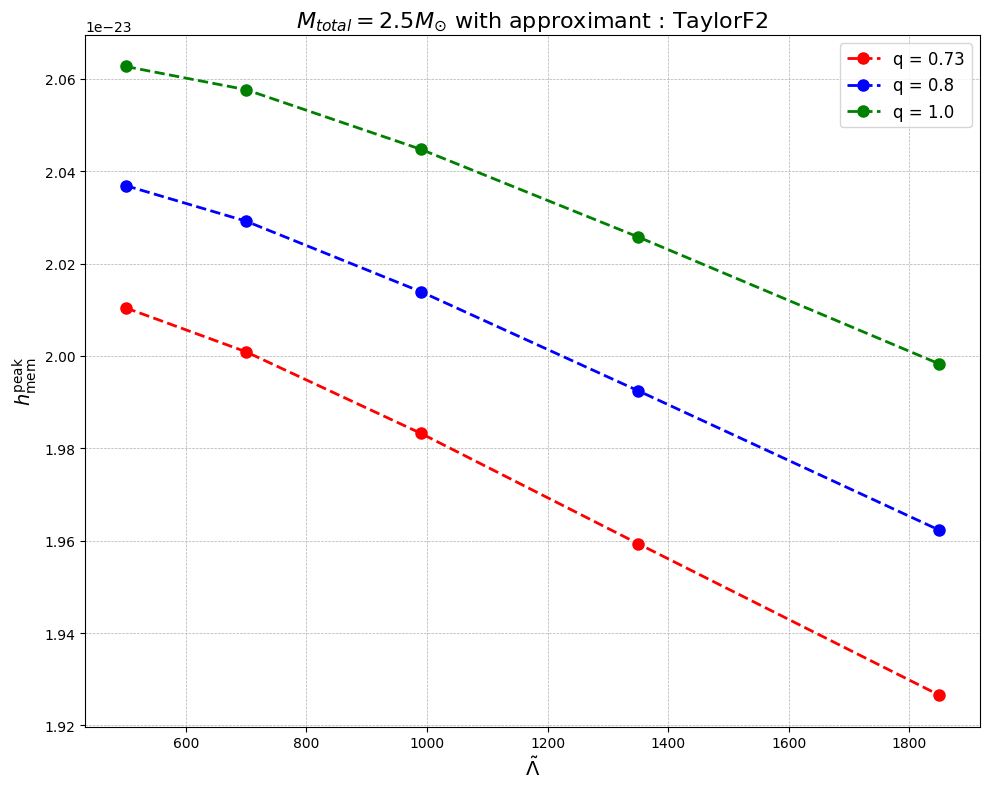

In [7]:
# Paramètres utilisées
lambda_tilde = np.array([500, 700, 990, 1350, 1850])  # à refined avec modèles d'EOS
m_tot = 2.5
d = 100  # Mpc
q_array = np.array([0.73, 0.8, 1])
incl = np.pi/2  
approx = ["SEOBNRv4_ROM_NRTidalv2", "IMRPhenomPv2_NRTidal","IMRPhenomD_NRTidal",
          "TaylorT4", "TaylorF2"]
colors = ['red', 'blue', 'green']

for approximant in approx:
    try: 
        fig, ax = plt.subplots(figsize=(10, 8))
        for (q, color) in zip(q_array, colors):
            h_mem_max_values = []
            for lam in lambda_tilde:
                _, hmem = generate_h_mem(m_tot, lam, q, d, incl, extension_time=0.2, approximant=approximant)
                hmem_max = np.max(np.abs(hmem))
                h_mem_max_values.append(hmem_max)
            ax.plot(lambda_tilde, h_mem_max_values, color=color, marker='o', linestyle='--', linewidth=2, markersize=8, label=f'q = {q}')


        ax.set_xlabel(r'$\tilde{\Lambda}$', fontsize=14)
        ax.set_ylabel(r'$h^{\mathrm{peak}}_{\mathrm{mem}}$', fontsize=14)
        ax.set_title(rf'$M_{{total}} = {m_tot}M_{{\odot}}$ with approximant : {approximant}', fontsize=16)
        ax.legend(loc='upper right', fontsize=12)
        ax.grid(True, which='both', linestyle='--', linewidth=0.5)
        #ax.set_ylim(0.6*10**(-23), 1.85*10**(-23)) # ylim idem que l'article 
        plt.tight_layout()
        plt.show()
    except Exception as e:
        print(f"Error with approximant {approximant}: {e}")

Value of lambda1: 446.60843758987346, lambda2: 92.585126516168 for q=0.73 and lam_tilde=200
Value of lambda1: 915.5472970592406, lambda2: 189.7995093581444 for q=0.73 and lam_tilde=410
Value of lambda1: 1339.8253127696203, lambda2: 277.755379548504 for q=0.73 and lam_tilde=600
Value of lambda1: 1898.085859756962, lambda2: 393.48678769371395 for q=0.73 and lam_tilde=850
Value of lambda1: 2657.320203659747, lambda2: 550.8815027711996 for q=0.73 and lam_tilde=1190
Value of lambda1: 416.26848041457094, lambda2: 98.78246166087963 for q=0.75 and lam_tilde=200
Value of lambda1: 853.3503848498705, lambda2: 202.50404640480323 for q=0.75 and lam_tilde=410
Value of lambda1: 1248.805441243713, lambda2: 296.3473849826389 for q=0.75 and lam_tilde=600
Value of lambda1: 1769.1410417619265, lambda2: 419.8254620587384 for q=0.75 and lam_tilde=850
Value of lambda1: 2476.797458466697, lambda2: 587.7556468822338 for q=0.75 and lam_tilde=1190
Value of lambda1: 402.20136427064944, lambda2: 101.97917653700515

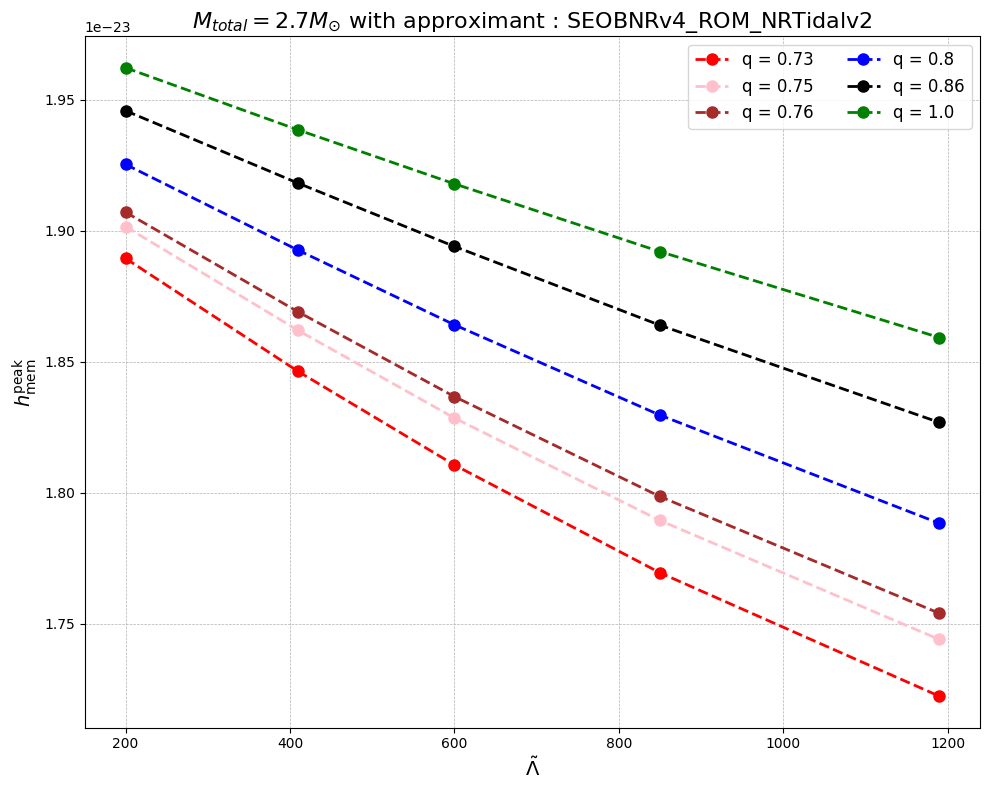

Value of lambda1: 446.60843758987346, lambda2: 92.585126516168 for q=0.73 and lam_tilde=200
Value of lambda1: 915.5472970592406, lambda2: 189.7995093581444 for q=0.73 and lam_tilde=410
Value of lambda1: 1339.8253127696203, lambda2: 277.755379548504 for q=0.73 and lam_tilde=600
Value of lambda1: 1898.085859756962, lambda2: 393.48678769371395 for q=0.73 and lam_tilde=850
Value of lambda1: 2657.320203659747, lambda2: 550.8815027711996 for q=0.73 and lam_tilde=1190
Value of lambda1: 416.26848041457094, lambda2: 98.78246166087963 for q=0.75 and lam_tilde=200
Value of lambda1: 853.3503848498705, lambda2: 202.50404640480323 for q=0.75 and lam_tilde=410
Value of lambda1: 1248.805441243713, lambda2: 296.3473849826389 for q=0.75 and lam_tilde=600
Value of lambda1: 1769.1410417619265, lambda2: 419.8254620587384 for q=0.75 and lam_tilde=850
Value of lambda1: 2476.797458466697, lambda2: 587.7556468822338 for q=0.75 and lam_tilde=1190
Value of lambda1: 402.20136427064944, lambda2: 101.97917653700515

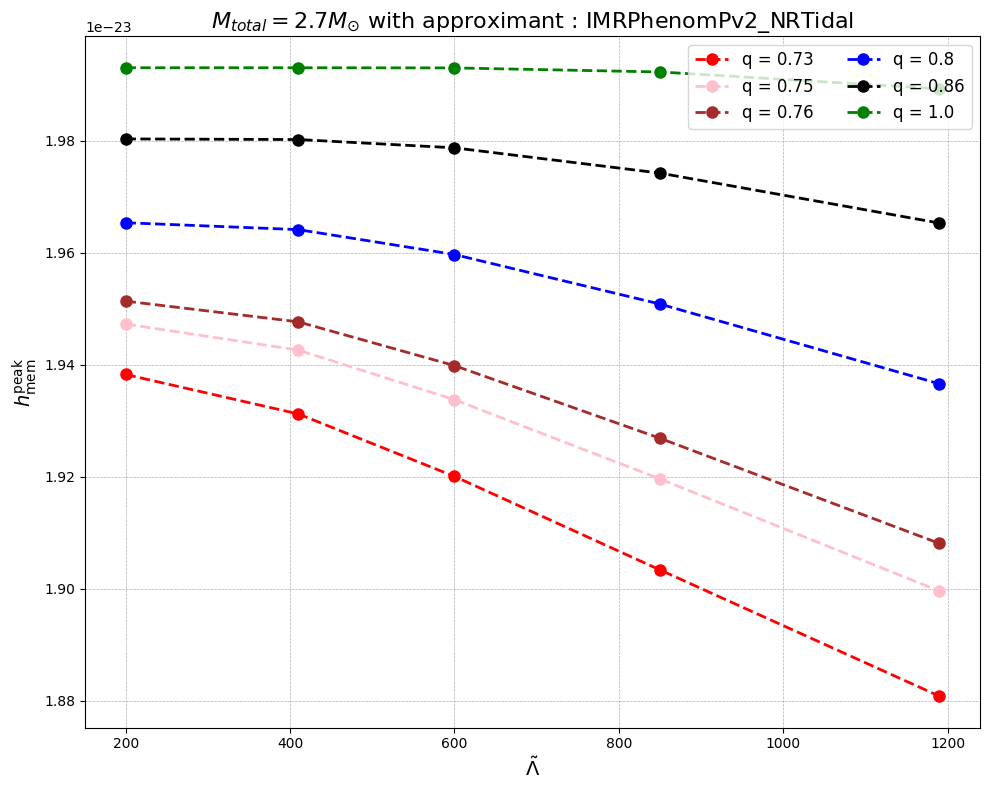

Value of lambda1: 446.60843758987346, lambda2: 92.585126516168 for q=0.73 and lam_tilde=200
Value of lambda1: 915.5472970592406, lambda2: 189.7995093581444 for q=0.73 and lam_tilde=410
Value of lambda1: 1339.8253127696203, lambda2: 277.755379548504 for q=0.73 and lam_tilde=600
Value of lambda1: 1898.085859756962, lambda2: 393.48678769371395 for q=0.73 and lam_tilde=850
Value of lambda1: 2657.320203659747, lambda2: 550.8815027711996 for q=0.73 and lam_tilde=1190
Value of lambda1: 416.26848041457094, lambda2: 98.78246166087963 for q=0.75 and lam_tilde=200
Value of lambda1: 853.3503848498705, lambda2: 202.50404640480323 for q=0.75 and lam_tilde=410
Value of lambda1: 1248.805441243713, lambda2: 296.3473849826389 for q=0.75 and lam_tilde=600
Value of lambda1: 1769.1410417619265, lambda2: 419.8254620587384 for q=0.75 and lam_tilde=850
Value of lambda1: 2476.797458466697, lambda2: 587.7556468822338 for q=0.75 and lam_tilde=1190
Value of lambda1: 402.20136427064944, lambda2: 101.97917653700515

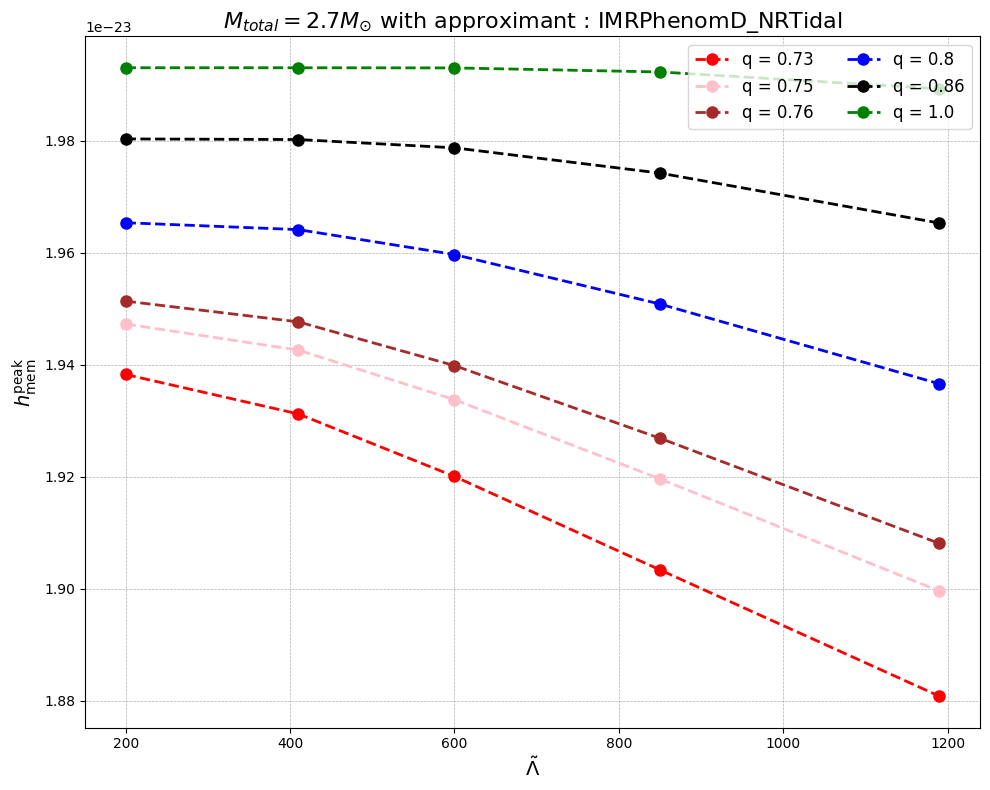

Value of lambda1: 446.60843758987346, lambda2: 92.585126516168 for q=0.73 and lam_tilde=200
Value of lambda1: 915.5472970592406, lambda2: 189.7995093581444 for q=0.73 and lam_tilde=410
Value of lambda1: 1339.8253127696203, lambda2: 277.755379548504 for q=0.73 and lam_tilde=600
Value of lambda1: 1898.085859756962, lambda2: 393.48678769371395 for q=0.73 and lam_tilde=850
Value of lambda1: 2657.320203659747, lambda2: 550.8815027711996 for q=0.73 and lam_tilde=1190
Value of lambda1: 416.26848041457094, lambda2: 98.78246166087963 for q=0.75 and lam_tilde=200
Value of lambda1: 853.3503848498705, lambda2: 202.50404640480323 for q=0.75 and lam_tilde=410
Value of lambda1: 1248.805441243713, lambda2: 296.3473849826389 for q=0.75 and lam_tilde=600
Value of lambda1: 1769.1410417619265, lambda2: 419.8254620587384 for q=0.75 and lam_tilde=850
Value of lambda1: 2476.797458466697, lambda2: 587.7556468822338 for q=0.75 and lam_tilde=1190
Value of lambda1: 402.20136427064944, lambda2: 101.97917653700515

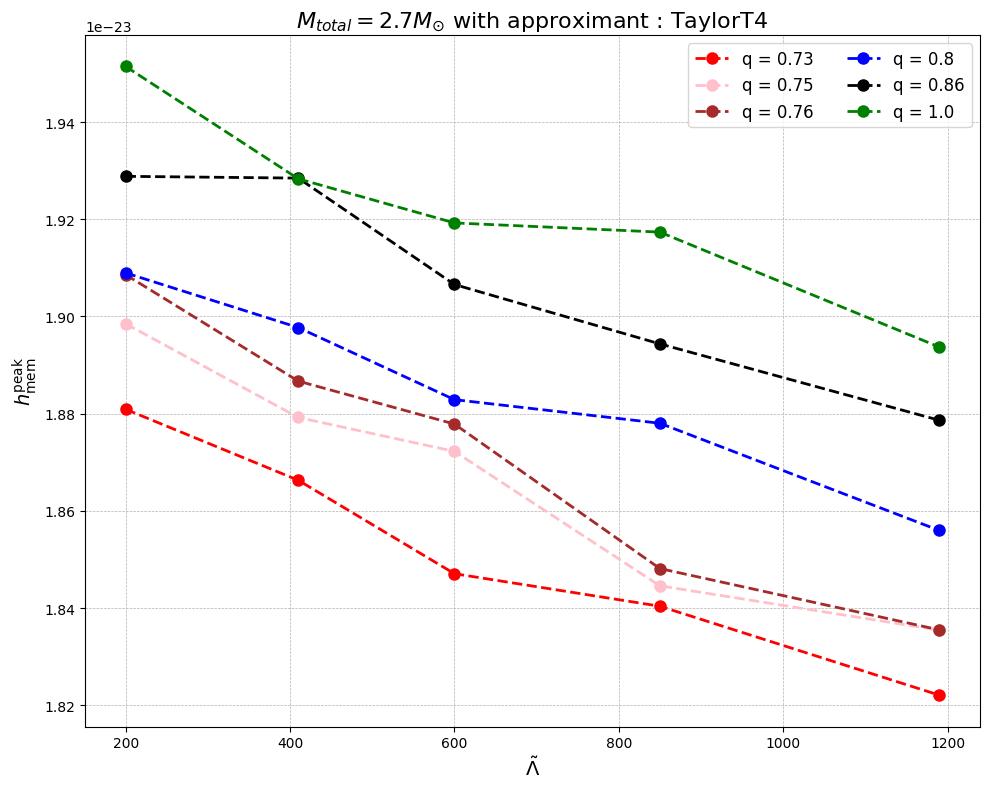

Value of lambda1: 446.60843758987346, lambda2: 92.585126516168 for q=0.73 and lam_tilde=200
Value of lambda1: 915.5472970592406, lambda2: 189.7995093581444 for q=0.73 and lam_tilde=410
Value of lambda1: 1339.8253127696203, lambda2: 277.755379548504 for q=0.73 and lam_tilde=600
Value of lambda1: 1898.085859756962, lambda2: 393.48678769371395 for q=0.73 and lam_tilde=850
Value of lambda1: 2657.320203659747, lambda2: 550.8815027711996 for q=0.73 and lam_tilde=1190
Value of lambda1: 416.26848041457094, lambda2: 98.78246166087963 for q=0.75 and lam_tilde=200
Value of lambda1: 853.3503848498705, lambda2: 202.50404640480323 for q=0.75 and lam_tilde=410
Value of lambda1: 1248.805441243713, lambda2: 296.3473849826389 for q=0.75 and lam_tilde=600
Value of lambda1: 1769.1410417619265, lambda2: 419.8254620587384 for q=0.75 and lam_tilde=850
Value of lambda1: 2476.797458466697, lambda2: 587.7556468822338 for q=0.75 and lam_tilde=1190
Value of lambda1: 402.20136427064944, lambda2: 101.97917653700515

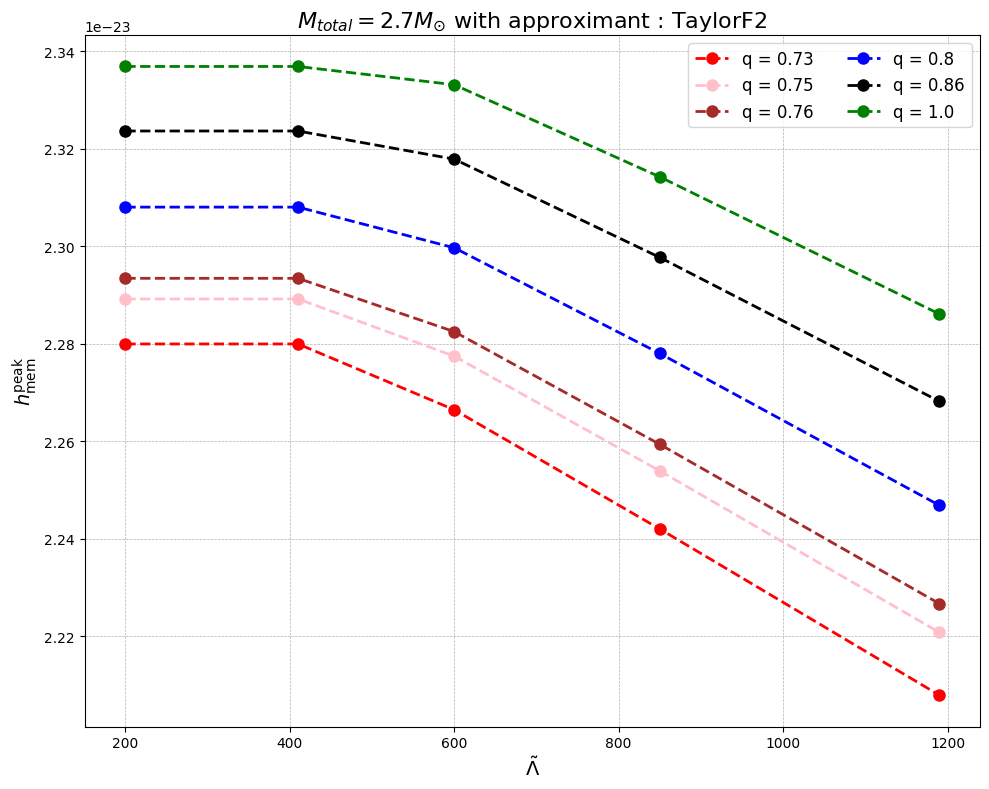

In [11]:
# Paramètres utilisées
lambda_tilde = np.array([200,410, 600, 850, 1190])  # à refined avec modèles d'EOS
m_tot = 2.7
d = 100  # Mpc
q_array = np.array([0.73, 0.75, 0.76, 0.8, 0.86, 1])
incl = np.pi/2  
approx = ["SEOBNRv4_ROM_NRTidalv2", "IMRPhenomPv2_NRTidal","IMRPhenomD_NRTidal",
          "TaylorT4", "TaylorF2"]
colors = ['red', 'pink', 'brown' , 'blue', 'black', 'green']

for approximant in approx:
    try: 
        fig, ax = plt.subplots(figsize=(10, 8))
        for (q, color) in zip(q_array, colors):
            h_mem_max_values = []
            for lam in lambda_tilde:
                _, hmem = generate_h_mem(m_tot, lam, q, d, incl, extension_time=0.2, approximant=approximant)
                hmem_max = np.max(np.abs(hmem))
                h_mem_max_values.append(hmem_max)
            ax.plot(lambda_tilde, h_mem_max_values, color=color, marker='o', linestyle='--', linewidth=2, markersize=8, label=f'q = {q}')


        ax.set_xlabel(r'$\tilde{\Lambda}$', fontsize=14)
        ax.set_ylabel(r'$h^{\mathrm{peak}}_{\mathrm{mem}}$', fontsize=14)
        ax.set_title(rf'$M_{{total}} = {m_tot}M_{{\odot}}$ with approximant : {approximant}', fontsize=16)
        ax.legend(loc='upper right', fontsize=12, ncol=2)
        ax.grid(True, which='both', linestyle='--', linewidth=0.5)
        #ax.set_ylim(0.6*10**(-23), 1.85*10**(-23)) # ylim idem que l'article 
        plt.tight_layout()
        plt.show()
    except Exception as e:
        print(f"Error with approximant {approximant}: {e}")

Value of lambda1: 0.0, lambda2: 0.0 for q=1.0 and lam_tilde=0


/usr/local/lib64/python3.11/site-packages/matplotlib/cbook.py:1719: ComplexWarning: Casting complex values to real discards the imaginary part
  return math.isfinite(val)
/usr/local/lib64/python3.11/site-packages/matplotlib/cbook.py:1355: ComplexWarning: Casting complex values to real discards the imaginary part
  return np.asarray(x, float)


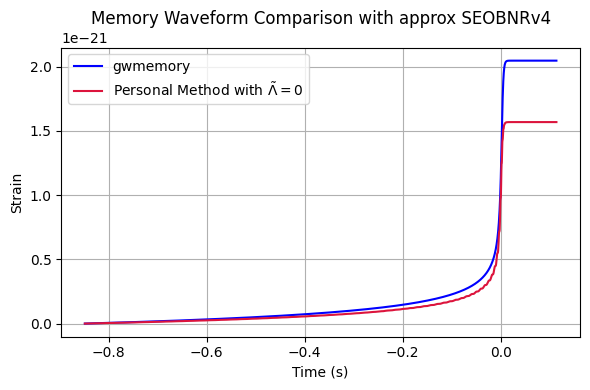

In [6]:
# Test avec entre gwmemory et ma méthode perso avec un approximant semblable
import gwmemory
lambda_tilde = 0  # set à 0 pour test 
def plot_memory_analysis(total_mass, model_gwmemory, model_perso):
    try:
        distance = 100  # Mpc
        inclination = np.pi / 2  # edge-on
        
        # Calcul de la mémoire avec ma méthode perso
        t_personal, h_mem_personal = generate_h_mem(
            mtot=total_mass,
            lam_tilde=lambda_tilde,
            q=1.0,
            distance=distance,
            inclination=inclination,
            extension_time=0.0,
            approximant=model_perso, 
        )
        parameters = dict(
        total_mass=total_mass,
        distance=distance,
        q=1.0,
        spin_1=[0.0, 0.0, 0.0],
        spin_2=[0.0, 0.0, 0.0],
        times=t_personal,
        model=model_gwmemory
        )
        h_mem, t_mem = gwmemory.time_domain_memory(**parameters)
        h_mem_20 = h_mem.get((2,0), None)

        fig, ax = plt.subplots(figsize=(6, 4))

        ax.plot(t_mem, h_mem_20, label='gwmemory', color='blue')
        ax.plot(t_personal, h_mem_personal, label=rf'Personal Method with $\tilde{{\Lambda}} = {lambda_tilde}$', color='crimson', linestyle='-')
        ax.set_title(f'Memory Waveform Comparison with approx {model_gwmemory}')
        ax.set_xlabel('Time (s)')
        ax.set_ylabel('Strain')
        ax.legend()
        ax.grid()
        plt.tight_layout()
        plt.show()
    except Exception as e:
        print(f"Error in plot_memory_analysis: {e}")
# Test avec SeOBNRv4 et SEOBNRv4_ROM_NRTidalv2
plot_memory_analysis(total_mass=60, model_gwmemory="SEOBNRv4", model_perso="SEOBNRv4")
# Test avec IMRPhenomD et IMRPhenomD_NRTidal
#plot_memory_analysis(total_mass=5, model_gwmemory="IMRPhenomD", model_perso="IMRPhenomD_NRTidal")

In [10]:
help(gwmemory.time_domain_memory)

Help on function time_domain_memory in module gwmemory.gwmemory:

time_domain_memory(model: str = None, h_lm: dict = None, times: numpy.ndarray = None, q: float = None, total_mass: float = None, spin_1: Tuple[float, float, float] = None, spin_2: Tuple[float, float, float] = None, distance: float = None, inc: float = None, phase: float = None, **kwargs) -> Tuple[dict, numpy.ndarray]
    Calculate the time domain memory waveform according to __reference__.
    
    Example usage:
    
    Using NR surrogate waveform __reference__ for an edge-on non-spinning,
    equal-mass, binary at a distance of 400 MPC.
    
    h_mem, times = time_domain_memory(model='NRSur7dq2', q=1, total_mass=60,
                                      distance=400, inc=np.pi/2, phase=0)
    
    
    Using an EOBNR waveform __reference__ for an edge-on non-spinning,
    equal-mass, binary at a distance of 400 MPC.
    
    h_mem, times = time_domain_memory(model='SEOBNRv4', q=1, total_mass=60,
                     

Value of lambda1: 0.0, lambda2: 0.0 for q=1.0 and lam_tilde=0


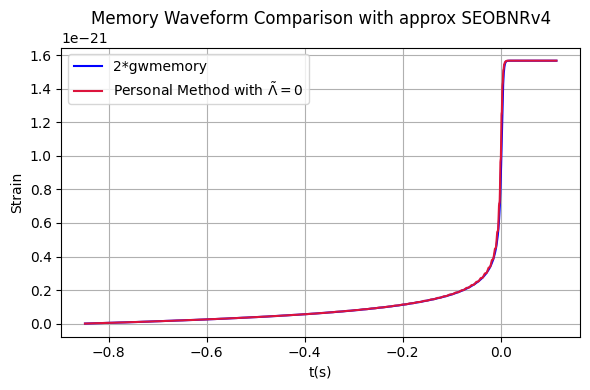

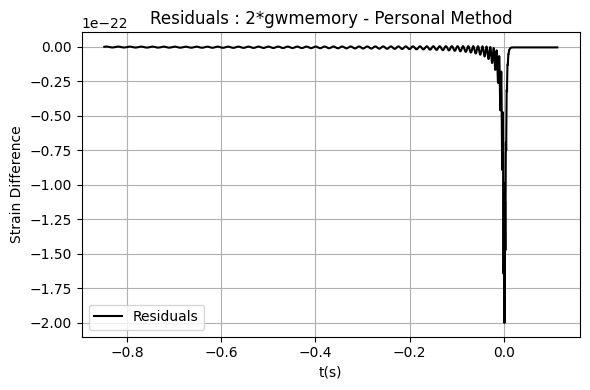

In [7]:
# Test avec entre gwmemory et ma méthode perso avec un approximant semblable
import gwmemory
lambda_tilde = 0  # set à 0 pour test 
def plot_memory_analysis(total_mass, model_gwmemory, model_perso):
    try:
        distance = 100  # Mpc
        inclination = np.pi / 2  # edge-on
        
        # Calcul de la mémoire avec ma méthode perso
        t_personal, h_mem_personal = generate_h_mem(
            mtot=total_mass,
            lam_tilde=lambda_tilde,
            q=1.0,
            distance=distance,
            inclination=inclination,
            extension_time=0.0,
            approximant=model_perso, 
        )
        parameters = dict(
        total_mass=total_mass,
        distance=distance,
        inc=inclination,
        q=1.0,
        phase=0,
        spin_1=[0.0, 0.0, 0.0],
        spin_2=[0.0, 0.0, 0.0],
        times=t_personal,
        model=model_gwmemory
        )
        h_mem, t_mem = gwmemory.time_domain_memory(**parameters)

        fig, ax = plt.subplots(figsize=(6, 4))

        ax.plot(t_mem, 2*h_mem['plus'], label='2*gwmemory', color='blue')
        ax.plot(t_personal, h_mem_personal, label=rf'Personal Method with $\tilde{{\Lambda}} = {lambda_tilde}$', color='crimson', linestyle='-')
        ax.set_title(f'Memory Waveform Comparison with approx {model_gwmemory}')
        ax.set_xlabel('t(s)')
        ax.set_ylabel('Strain')
        ax.legend()
        ax.grid()
        plt.tight_layout()
        plt.show()
        # Résidus
        plt.figure(figsize=(6, 4))
        plt.plot(t_mem, 2*h_mem['plus'] - h_mem_personal, label='Residuals', color='k')
        plt.title('Residuals : 2*gwmemory - Personal Method')
        plt.xlabel('t(s)')
        plt.ylabel('Strain Difference')
        plt.legend()
        plt.grid()
        plt.tight_layout()
        plt.show()
    except Exception as e:
        print(f"Error in plot_memory_analysis: {e}")
        
# Test avec SeOBNRv4 et SEOBNRv4_ROM_NRTidalv2
plot_memory_analysis(total_mass=60, model_gwmemory="SEOBNRv4", model_perso="SEOBNRv4")
# Test avec IMRPhenomD et IMRPhenomD_NRTidal
#plot_memory_analysis(total_mass=5, model_gwmemory="IMRPhenomD", model_perso="IMRPhenomD_NRTidal")


Value of lambda1: 0.0, lambda2: 0.0 for q=1.0 and lam_tilde=0


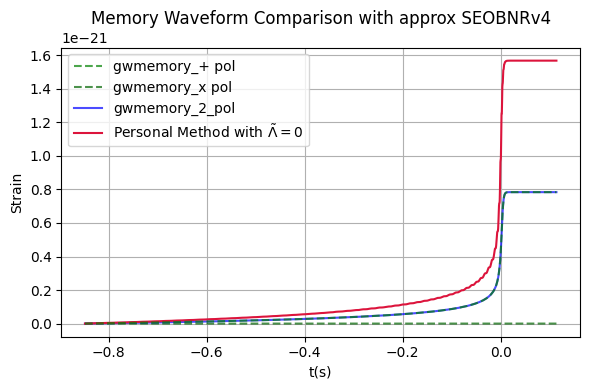

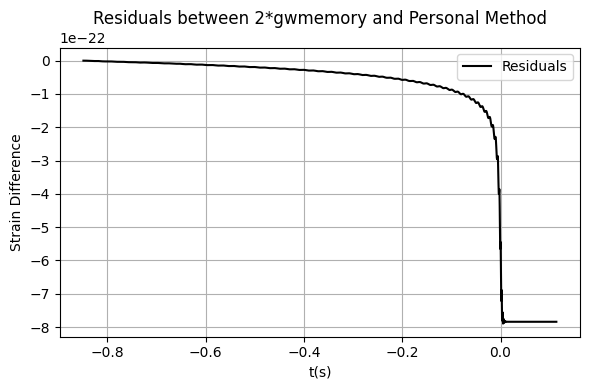

In [ ]:
# Courbe des 'résidus' entre les deux méthodes
# Test avec entre gwmemory et ma méthode perso avec un approximant semblable
import gwmemory
lambda_tilde = 0  # set à 0 pour test 
def plot_memory_analysis(total_mass, model_gwmemory, model_perso):
    try:
        distance = 100  # Mpc
        inclination = np.pi / 2  # edge-on
        
        # Calcul de la mémoire avec ma méthode perso
        t_personal, h_mem_personal = generate_h_mem(
            mtot=total_mass,
            lam_tilde=lambda_tilde,
            q=1.0,
            distance=distance,
            inclination=inclination,
            extension_time=0.0,
            approximant=model_perso, 
        )
        h_lm = dict()
        parameters = dict(
        total_mass=total_mass,
        distance=distance,
        inc=inclination, 
        q=1.0,
        phase=0,
        spin_1=[0.0, 0.0, 0.0],
        spin_2=[0.0, 0.0, 0.0],
        times=t_personal,
        model=model_gwmemory
        )
        h_mem, t_mem = gwmemory.time_domain_memory(**parameters)
        
        h_mem_gwmemory = h_mem['plus'] + h_mem['cross']  # somme des polarisations

        fig, ax = plt.subplots(figsize=(6, 4))
        # Plot des 2 polarisations 
        ax.plot(t_mem, h_mem['plus'], label='gwmemory_+ pol', color='green', linestyle='--', alpha=0.7, zorder =5)
        ax.plot(t_mem, h_mem['cross'], label='gwmemory_x pol', color='darkgreen', linestyle='--', alpha= 0.7)
        ax.plot(t_mem, h_mem_gwmemory, label='gwmemory_2_pol', color='blue', alpha= 0.7)
        ax.plot(t_personal, h_mem_personal, label=rf'Personal Method with $\tilde{{\Lambda}} = {lambda_tilde}$', color='crimson', linestyle='-')
        ax.set_title(f'Memory Waveform Comparison with approx {model_gwmemory}')
        ax.set_xlabel('t(s)')
        ax.set_ylabel('Strain')
        ax.legend()
        ax.grid()
        plt.tight_layout()
        plt.show()
        # Résidus
        plt.figure(figsize=(6, 4))
        plt.plot(t_mem, h_mem_gwmemory - h_mem_personal, label='Residuals', color='k')
        plt.title('Residuals between 2*gwmemory and Personal Method')
        plt.xlabel('t(s)')
        plt.ylabel('Strain Difference')
        plt.legend()
        plt.grid()
        plt.tight_layout()
        plt.show()
    except Exception as e:
        print(f"Error in plot_memory_analysis: {e}")
        
# Test avec SeOBNRv4 et SEOBNRv4_ROM_NRTidalv2
plot_memory_analysis(total_mass=60, model_gwmemory="SEOBNRv4", model_perso="SEOBNRv4")
# Test avec IMRPhenomD et IMRPhenomD_NRTidal
#plot_memory_analysis(total_mass=5, model_gwmemory="IMRPhenomD", model_perso="IMRPhenomD_NRTidal")


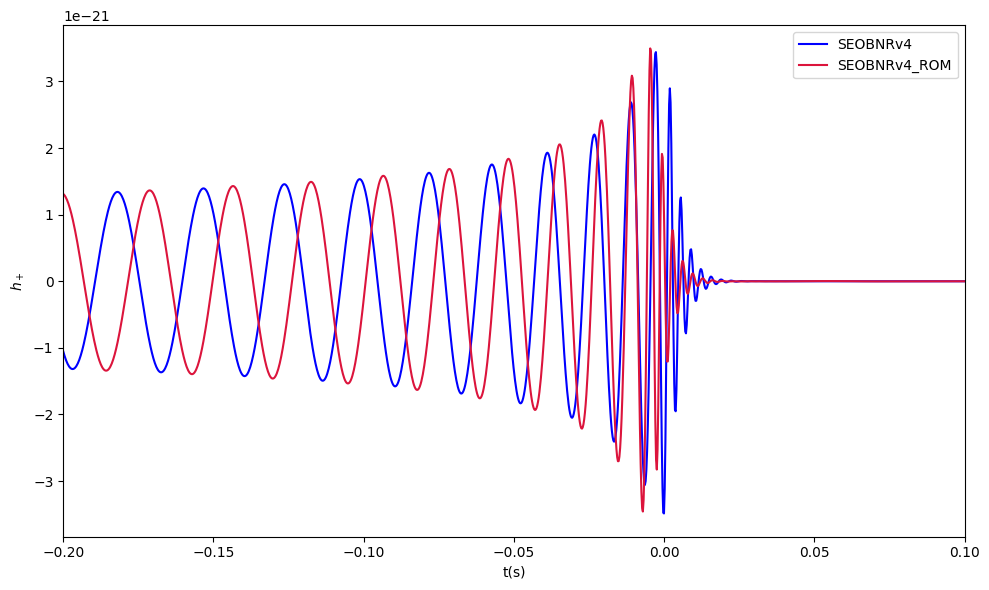

In [120]:
total_mass = 60
distance = 100
inclination = np.pi / 2
delta_t = 1.0 / 4096
f_lower = 20.0

# Approximants à comparer
approximants = [
    ("SEOBNRv4", {}),
    ("SEOBNRv4_ROM", {"lambda1": 0, "lambda2": 0})
    
]
colors = ['blue', 'crimson', 'green']
plt.figure(figsize=(10, 6))

for i,(label, extra_args) in enumerate(approximants):
    hp, hc = get_td_waveform(
        approximant=label,
        mass1=total_mass / 2,
        mass2=total_mass / 2,
        distance=distance,
        inclination=inclination,
        delta_t=delta_t,
        f_lower=f_lower,
        **extra_args
    )
    t = hp.sample_times.numpy()
    plt.plot(t, hp.numpy(), label=f"{label}", color=colors[i])
plt.xlim(-0.2, 0.1)
plt.xlabel("t(s)")
plt.ylabel("$h_+$")
plt.legend()
plt.tight_layout()
plt.show()

Différence entre les 2 méthodes : Le saut mémoire de GWmemory est ~2x plus grand. Peut être parce que GWmemory ne tient pas compte de la déformabilité tidal (pas inclus dans les params)?

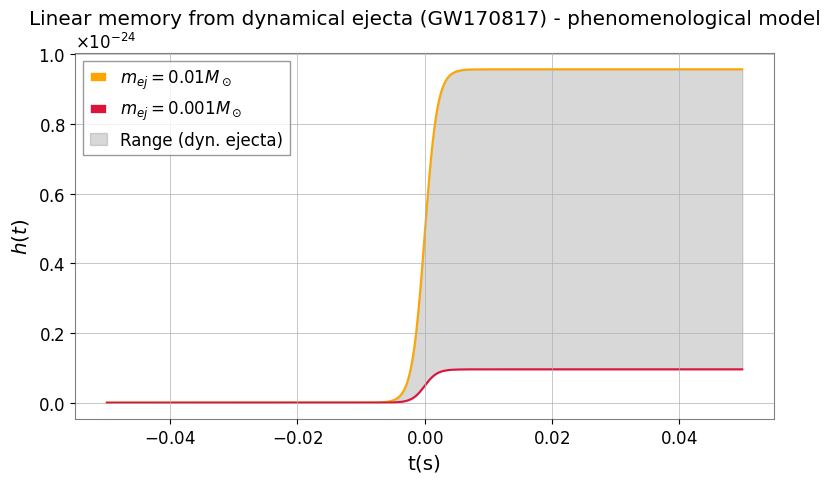

In [6]:
from lal import MSUN_SI, PC_SI, C_SI, G_SI
# Paramètres très généraux pour l'éjecta !dynamique! de GW170817
m_ej_min = 1e-3 * MSUN_SI  # kg
m_ej_max = 1e-2 * MSUN_SI  # kg
v_ej = 0.2 * C_SI           # m/s
r = 40 * 1e6 * PC_SI        # m
tau = 1e-3              # s - temps d'éjection de la matière - de l'ordre de  << qq ms

# Calcul deltah min et max
delta_h_min = (2 * G_SI * m_ej_min * v_ej**2) / (C_SI**4 * r)
delta_h_max = (2 * G_SI * m_ej_max * v_ej**2) / (C_SI**4 * r)

t = np.linspace(-0.05, 0.05, 1000)

# Forme temporelle
h_min = delta_h_min / (1 + np.exp(-t / tau))
h_max = delta_h_max / (1 + np.exp(-t / tau))

plt.figure(figsize=(8,5))
plt.plot(t, h_max, label=rf"$m_{{ej}} = {m_ej_max/ MSUN_SI}M_\odot$", color='orange')
plt.plot(t, h_min, label=rf"$m_{{ej}} = {m_ej_min/ MSUN_SI}M_\odot$", color='crimson')
plt.fill_between(t, h_min, h_max, color='gray', alpha=0.3, label="Range (dyn. ejecta)")
plt.xlabel("t(s)")
plt.ylabel(r"$h(t)$")
plt.title("Linear memory from dynamical ejecta (GW170817) - phenomenological model")
plt.legend()
plt.tight_layout()
plt.show()

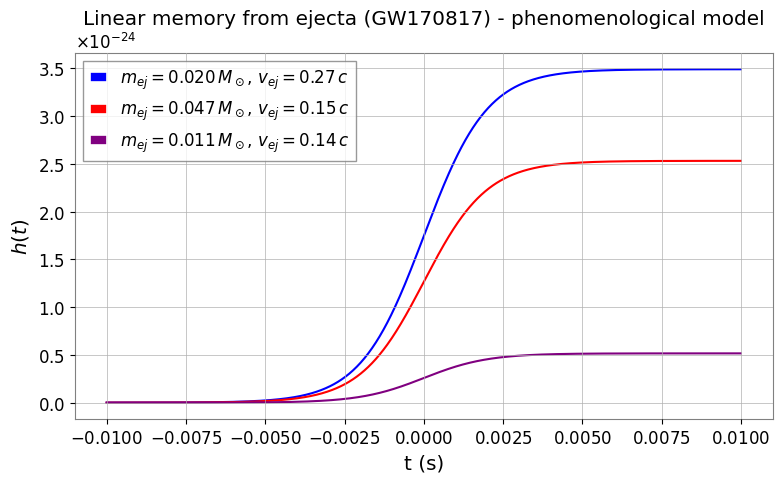

In [7]:
from lal import MSUN_SI, PC_SI, C_SI, G_SI
# paramètres de GW170817 (Villar et al. 2017) - venant de thèse Marion pour GW170817 pour composantes blue / red / purple de l'éjecta totale
M_ej = np.array([0.02, 0.047, 0.011])
M_ej *= MSUN_SI          # convertir en kg
v_ej_values = np.array([0.27, 0.15, 0.14])
v_ej_values *= C_SI      # convertir en m/s
r = 40 * PC_SI * 1e6     # distance en mètres (40 Mpc)
colors = ['blue', 'red', 'purple']

tau = 0.001        # temps caractéristique en secondes - à ajuster ! (essayer de le fit sur la simulation ?)

# calcul de delta_h 
delta_h = 2 * G_SI / (C_SI**4 * r) * M_ej * v_ej_values**2  # tableau de longueur 3

# Grille temporelle
t = np.linspace(-0.01, 0.01, 1000)

# h(t) pour chaque composante 
h_lin = delta_h[None, :] / (1 + np.exp(-t[:, None] / tau))

# Plot
plt.figure(figsize=(8, 5))

for i, (m_ej, v_ej) in enumerate(zip(M_ej, v_ej_values)):
    plt.plot(t, h_lin[:, i],
             label=f"$m_{{ej}}={m_ej/MSUN_SI:.3f}\\,M_\odot$, $v_{{ej}}={v_ej/C_SI:.2f}\\,c$",
             color=colors[i])

plt.xlabel("t (s)")
plt.ylabel(r"$h(t)$")
plt.title("Linear memory from ejecta (GW170817) - phenomenological model")
plt.legend()
plt.tight_layout()
plt.show()

---

# Profil de densité ejecta(e)

Test de 2 modèles de densité d'éjecta présenté dans https://arxiv.org/pdf/1908.05815 (eq. 3)

In [8]:
from lal import C_SI
# Parameters
c = C_SI
f_d_pol = 0.025  # density contrast for polar region

# Angular function (eq 4 - eq 5)
def Theta(theta):
    """Transition function between polar and equatorial regions"""
    return 1.0 / (1.0 + np.exp(-10 * (theta - np.pi/4)))

def eta(theta, f_d_pol=f_d_pol):
    """Angular density profile for dynamical ejecta"""
    return (1 - Theta(theta)) * f_d_pol + Theta(theta)

# Modified density profile function
def rho_profile_model1(r, t, theta, v_pm_min, v_pm_max, v_d_min, v_max, f_d_pol=0.025):
    """
    Compute the density profile for a simple ejecta model with dynamical and post-merger components
    Assume that the post-merger ejecta won't reach the highest velocities of the dynamical ejecta
    
    Parameters:
        r: radius (m)
        t: time (s)
        theta: polar angle (radians)
        v_pm_min: minimum velocity for post-merger ejecta (in units of c)
        v_pm_max: maximum velocity for post-merger ejecta (in units of c)
        v_d_min: minimum velocity for dynamical ejecta (in units of c)
        v_max: maximum velocity for dynamical ejecta (in units of c) = 0.9 c
    Returns:
        rho_dyn: density of dynamical ejecta
        rho_pm: density of post-merger ejecta
        rho_tot: total density (sum of both)
    """
    v = r / t / c
    eta_theta = eta(theta, f_d_pol)
    t_day = t / 86400  # t in days
    rho_floor = 1e-20 * t_day**-3  # g/cm^3
    if v_pm_max > v_d_min:
        raise ValueError("In this model, v_pm_max must be less than v_d_min !")
    # Dynamical ejecta
    if v_d_min <= v < 0.4:
        rho_dyn = eta_theta * r**-4 * t**-3
    elif 0.4 <= v < v_max:
        rho_dyn = eta_theta * r**-8 * t**-3
    else:
        rho_dyn = 0.0

    # Post-merger ejecta
    if v_pm_min <= v < v_pm_max:
        rho_pm = r**-3 * t**-3
    else:
        rho_pm = 0.0

    # Floor (if outside both regions)
    if v < v_pm_min or (v_pm_max <= v < v_d_min):
        rho_floor_val = rho_floor
    else:
        rho_floor_val = 0.0

    rho_tot = rho_dyn + rho_pm + rho_floor_val
    return rho_dyn, rho_pm, rho_tot

# Second model
def rho_profile_model2(r, t, theta, v_pm_min, v_pm_max, v_d_min, v_max, f_d_pol=0.025):
    """
    Second density profile model 
    - Allows v_pm_max > v_d_min.
    - In the overlap region (v_d_min < v < v_pm_max), for theta > pi/4, only dynamical ejecta is present.
    Parameters:
        r: radius (m)
        t: time (s)
        theta: polar angle (radians)
        v_pm_min: minimum velocity for post-merger ejecta (in units of c)
        v_pm_max: maximum velocity for post-merger ejecta (in units of c)
        v_d_min: minimum velocity for dynamical ejecta (in units of c)
        v_max: maximum velocity for dynamical ejecta (in units of c) =
    
    Returns:
        rho_dyn: density of dynamical ejecta
        rho_pm: density of post-merger ejecta
        rho_tot: total density (sum of both)
    """
    if v_pm_max > v_d_min:
        v = r / t / c
        eta_theta = eta(theta, f_d_pol)
        t_day = t / 86400
        rho_floor = 1e-20 * t_day**-3  # g/cm^3

        # Dynamical ejecta
        if v_d_min <= v < 0.4:
            rho_dyn = eta_theta * r**-4 * t**-3
        elif 0.4 <= v < v_max:
            rho_dyn = eta_theta * r**-8 * t**-3
        else:
            rho_dyn = 0.0

        # Post-merger ejecta (with truncation in overlap for theta > pi/4)
        if v_pm_min <= v < v_pm_max:
            if (v > v_d_min) and (theta > np.pi/4):
                rho_pm = 0.0  
            else:
                rho_pm = r**-3 * t**-3
        else:
            rho_pm = 0.0

        # Floor (if outside both regions)
        if v < v_pm_min or (v_pm_max <= v < v_d_min):
            rho_floor_val = rho_floor
        else:
            rho_floor_val = 0.0

        rho_tot = rho_dyn + rho_pm + rho_floor_val
        return rho_dyn, rho_pm, rho_tot
    else:
        # First model if v_pm_max <= v_d_min (same case)
        return rho_profile_model1(r, t, theta, v_pm_min, v_pm_max, v_d_min, v_max, f_d_pol)

In [ ]:
# fonction qui trace la densité de l'ej dynamique - post-merger - totale pour un modèle et ses params
def plot_ejecta_density_grid(model, model_name, t=0.01, v_pm_min=0.025, v_pm_max=0.15, v_d_min=0.15, v_max=0.9, n=200, f_d_pol=0.025):

    vx_grid = np.linspace(0, v_max, n)
    vz_grid = np.linspace(0, v_max, n)
    VX, VZ = np.meshgrid(vx_grid, vz_grid)
    THETA = np.arctan2(VX, VZ)

    rho_dyn = np.zeros_like(VX)
    rho_pm = np.zeros_like(VX)
    rho_tot = np.zeros_like(VX)
    for i in range(n):
        for j in range(n):
            v_tot = np.sqrt(VX[i, j]**2 + VZ[i, j]**2)
            r = v_tot * c * t
            theta_val = THETA[i, j] 
            dyn, pm, tot = model(r, t, theta_val, v_pm_min, v_pm_max, v_d_min, v_max, f_d_pol)
            rho_dyn[i, j] = dyn
            rho_pm[i, j] = pm
            rho_tot[i, j] = tot

    levels = np.linspace(-20, -9, 12)
    fig, axes = plt.subplots(1, 3, figsize=(18, 5), sharex=True, sharey=True)
    titles = ["Dynamical ejecta", "Post-merger ejecta", "Total density"]
    datas = [rho_dyn, rho_pm, rho_tot]
    cmaps = ['Reds', 'Blues', 'Greens']

    for ax, data, title, cmap in zip(axes, datas, titles, cmaps):
        im = ax.contourf(VX, VZ, np.log10(data + 1e-30), levels=levels, cmap=cmap)
        ax.set_xlabel(r'$v_x/c$')
        ax.set_title(title)
        ax.set_xlim(0, 0.5)
        ax.set_ylim(0, 0.5)
        fig.colorbar(im, ax=ax, orientation='vertical', label=r'$\log_{10}(\rho)$ [g/cm$^3$]')
    axes[0].set_ylabel(r'$v_z/c$')
    plt.suptitle(f"Ejecta density at t={t:.3f} s for model {model_name}", fontsize=16)
    plt.tight_layout(rect=[0, 0, 1, 0.95])
    plt.show()

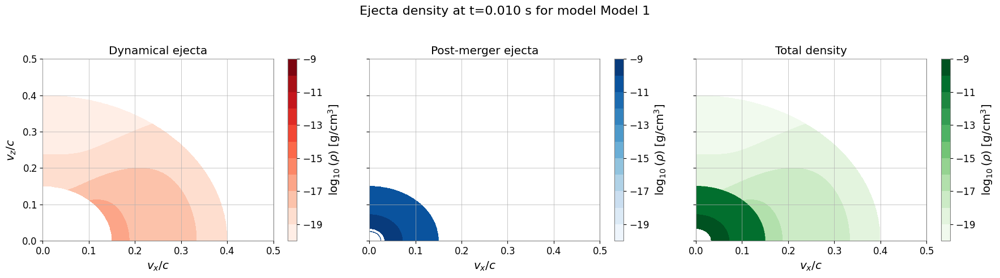

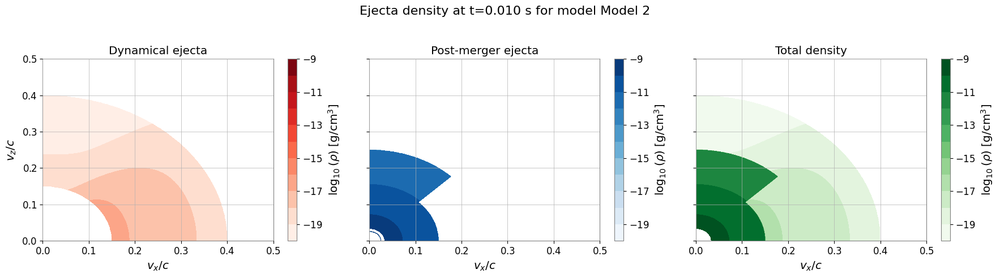

In [10]:
# Model 1 : 
plot_ejecta_density_grid(rho_profile_model1, "Model 1", t=0.01, v_pm_min=0.025, v_pm_max=0.15, v_d_min=0.15, v_max=0.9, n=1000)
# Model 2 avec v_pm_max > v_d_min
plot_ejecta_density_grid(rho_profile_model2, "Model 2", t=0.01, v_pm_min=0.025, v_pm_max=0.25, v_d_min=0.15, v_max=0.9, n=1000) 

In [ ]:
from IPython.display import HTML
from matplotlib import animation
from matplotlib.animation import PillowWriter
# Paramètres du modèle
model = rho_profile_model1  
model_name = "Model 1"
t_values = np.logspace(-2, np.log10(0.5), 30)  # de 0.01s à 0.5s 
v_pm_min = 0.025
v_pm_max = 0.1
v_d_min = 0.15
v_max = 0.9
n = 200
f_d_pol = 0.025

vx_grid = np.linspace(0, v_max, n)
vz_grid = np.linspace(0, v_max, n)
VX, VZ = np.meshgrid(vx_grid, vz_grid)
c = C_SI
THETA = np.arctan2(VX, VZ)

fig, axes = plt.subplots(1, 3, figsize=(18, 5), sharex=True, sharey=True)
titles = ["Dynamical ejecta", "Post-merger ejecta", "Total density"]
cmaps = ['Reds', 'Blues', 'Greens']
ims = []

levels = np.linspace(-20, -9, 12)

def compute_densities(t):
    rho_dyn = np.zeros_like(VX)
    rho_pm = np.zeros_like(VX)
    rho_tot = np.zeros_like(VX)
    for i in range(n):
        for j in range(n):
            v_tot = np.sqrt(VX[i, j]**2 + VZ[i, j]**2)
            r = v_tot * c * t
            theta_val = THETA[i, j]
            dyn, pm, tot = model(r, t, theta_val, v_pm_min, v_pm_max, v_d_min, v_max, f_d_pol)
            rho_dyn[i, j] = dyn
            rho_pm[i, j] = pm
            rho_tot[i, j] = tot
    return rho_dyn, rho_pm, rho_tot

# Initialisation
def init():
    for ax in axes:
        ax.clear()
    for ax, title in zip(axes, titles):
        ax.set_xlabel(r'$v_x/c$')
        ax.set_xlim(0, 0.5)
        ax.set_ylim(0, 0.5)
        ax.set_title(title)
    axes[0].set_ylabel(r'$v_z/c$')
    return axes

# Animation update
def animate(frame):
    t = t_values[frame]
    rho_dyn, rho_pm, rho_tot = compute_densities(t)
    datas = [rho_dyn, rho_pm, rho_tot]
    for ax, data, cmap in zip(axes, datas, cmaps):
        ax.clear()
        im = ax.contourf(VX, VZ, np.log10(data + 1e-30), levels=levels, cmap=cmap) #Ajout de 1e-30 pour ne pas diviser par 0
        ax.set_xlabel(r'$v_x/c$')
        ax.set_xlim(0, 0.5)
        ax.set_ylim(0, 0.5)
    axes[0].set_ylabel(r'$v_z/c$')
    axes[0].set_title("Dynamical ejecta")
    axes[1].set_title("Post-merger ejecta")
    axes[2].set_title("Total density")
    fig.suptitle(f"Ejecta density at t={t:.3f} s for {model_name}", fontsize=16)
    return axes

ani = animation.FuncAnimation(fig, animate, frames=len(t_values), init_func=init, blit=False, interval=250)
outdir = 'ejecta_density_plot'
writer = PillowWriter(fps=8)
ani.save(f'{outdir}/ejecta_density_{model_name.replace(" ", "_")}.gif', writer=writer, dpi=200)
plt.close(fig)
HTML(ani.to_jshtml())

/tmp/ipykernel_61467/1413328805.py:62: RuntimeWarning: divide by zero encountered in log10
  im = ax.contourf(VX, VZ, np.log10(data), levels=levels, cmap=cmap)
/tmp/ipykernel_61467/1413328805.py:62: RuntimeWarning: divide by zero encountered in log10
  im = ax.contourf(VX, VZ, np.log10(data), levels=levels, cmap=cmap)


In [ ]:
from IPython.display import HTML
from matplotlib import animation
from matplotlib.animation import PillowWriter
# Paramètres du modèle
model = rho_profile_model2  
model_name = "Model 2"
t_values = np.logspace(-2, np.log10(0.5), 30)  # de 0.01s à 0.5s 
v_pm_min = 0.025
v_pm_max = 0.25
v_d_min = 0.15
v_max = 0.9
n = 200
f_d_pol = 0.025

vx_grid = np.linspace(0, v_max, n)
vz_grid = np.linspace(0, v_max, n)
VX, VZ = np.meshgrid(vx_grid, vz_grid)
c = C_SI
THETA = np.arctan2(VX, VZ)

fig, axes = plt.subplots(1, 3, figsize=(18, 5), sharex=True, sharey=True)
titles = ["Dynamical ejecta", "Post-merger ejecta", "Total density"]
cmaps = ['Reds', 'Blues', 'Greens']
ims = []

levels = np.linspace(-20, -9, 12) # densité entre 10-20 et 10-9

def compute_densities(t):
    rho_dyn = np.zeros_like(VX)
    rho_pm = np.zeros_like(VX)
    rho_tot = np.zeros_like(VX)
    for i in range(n):
        for j in range(n):
            v_tot = np.sqrt(VX[i, j]**2 + VZ[i, j]**2)
            r = v_tot * c * t
            theta_val = THETA[i, j]
            dyn, pm, tot = model(r, t, theta_val, v_pm_min, v_pm_max, v_d_min, v_max, f_d_pol)
            rho_dyn[i, j] = dyn
            rho_pm[i, j] = pm
            rho_tot[i, j] = tot
    return rho_dyn, rho_pm, rho_tot

# Initialisation
def init():
    for ax in axes:
        ax.clear()
    for ax, title in zip(axes, titles):
        ax.set_xlabel(r'$v_x/c$')
        ax.set_xlim(0, 0.5)
        ax.set_ylim(0, 0.5)
        ax.set_title(title)
    axes[0].set_ylabel(r'$v_z/c$')
    return axes

# Animation update
def animate(frame):
    t = t_values[frame]
    rho_dyn, rho_pm, rho_tot = compute_densities(t)
    datas = [rho_dyn, rho_pm, rho_tot]
    for ax, data, cmap in zip(axes, datas, cmaps):
        ax.clear()
        im = ax.contourf(VX, VZ, np.log10(data + 1e-30), levels=levels, cmap=cmap)
        ax.set_xlabel(r'$v_x/c$')
        ax.set_xlim(0, 0.5)
        ax.set_ylim(0, 0.5)
    axes[0].set_ylabel(r'$v_z/c$')
    axes[0].set_title("Dynamical ejecta")
    axes[1].set_title("Post-merger ejecta")
    axes[2].set_title("Total density")
    fig.suptitle(f"Ejecta density at t={t:.3f} s for {model_name}", fontsize=16)
    return axes

ani = animation.FuncAnimation(fig, animate, frames=len(t_values), init_func=init, blit=False, interval=250)
outdir = 'ejecta_density_plot'
writer = PillowWriter(fps=8)
ani.save(f'{outdir}/ejecta_density_{model_name.replace(" ", "_")}.gif', writer=writer, dpi=200)
plt.close(fig)
HTML(ani.to_jshtml())

Test plot 3D de la distribution de la densité d'éjecta

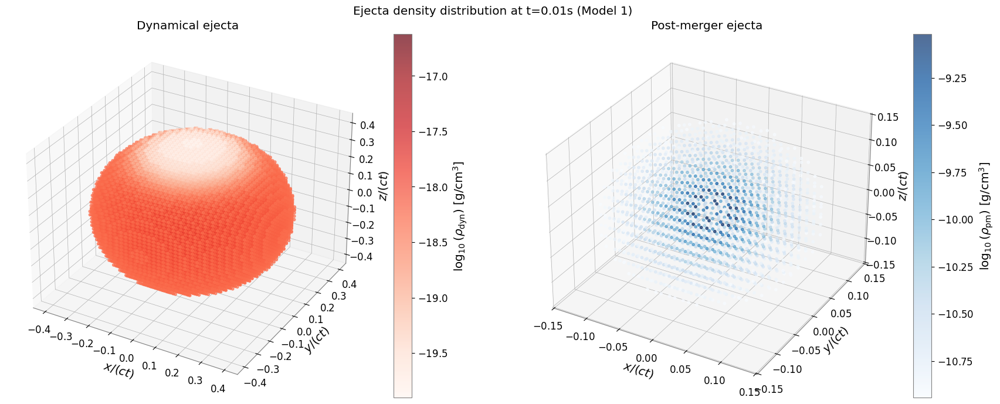

In [30]:
from mpl_toolkits.mplot3d import Axes3D  

t = 0.01
v_pm_min = 0.025
v_pm_max = 0.15
v_d_min = 0.15
v_max = 0.5
n = 50
f_d_pol = 0.025

# Grille en x, y, z centrée en 0
L = v_max * c * t
x = np.linspace(-L, L, n)
y = np.linspace(-L, L, n)
z = np.linspace(-L, L, n)
X, Y, Z = np.meshgrid(x, y, z, indexing='ij')

# Conversion en coordonnées sphériques
R = np.sqrt(X**2 + Y**2 + Z**2) # R = rayon
THETA = np.arccos(np.clip(Z / (R + 1e-30), -1, 1))  # éviter division par 0 

# Calcul des densités
rho_dyn = np.zeros_like(R)
rho_pm = np.zeros_like(R)
for i in range(n):
    for j in range(n):
        for k in range(n):
            r = R[i, j, k]
            theta = THETA[i, j, k]
            dyn, pm, _ = rho_profile_model1(r, t, theta, v_pm_min, v_pm_max, v_d_min, v_max, f_d_pol)
            rho_dyn[i, j, k] = dyn
            rho_pm[i, j, k] = pm

# Masques pour ne garder que les points significatifs
mask_dyn = rho_dyn > 1e-22
mask_pm = rho_pm > 1e-22

# Plot 3D scatter côte à côte
fig = plt.figure(figsize=(18, 7))

# Dynamical ejecta
ax1 = fig.add_subplot(121, projection='3d')
sc1 = ax1.scatter(
    X[mask_dyn]/(c*t), Y[mask_dyn]/(c*t), Z[mask_dyn]/(c*t),
    c=np.log10(rho_dyn[mask_dyn]), cmap='Reds', s=10, alpha=0.7
)
ax1.set_title("Dynamical ejecta")
ax1.set_xlabel(r'$x/(ct)$')
ax1.set_ylabel(r'$y/(ct)$')
ax1.set_zlabel(r'$z/(ct)$')
fig.colorbar(sc1, ax=ax1, label=r'$\log_{10}(\rho_\mathrm{dyn})$ [g/cm$^3$]')

# Post-merger ejecta
ax2 = fig.add_subplot(122, projection='3d')
sc2 = ax2.scatter(
    X[mask_pm]/(c*t), Y[mask_pm]/(c*t), Z[mask_pm]/(c*t),
    c=np.log10(rho_pm[mask_pm]), cmap='Blues', s=10, alpha=0.7
)
ax2.set_title("Post-merger ejecta")
ax2.set_xlabel(r'$x/(ct)$')
ax2.set_ylabel(r'$y/(ct)$')
ax2.set_zlabel(r'$z/(ct)$')
fig.colorbar(sc2, ax=ax2, label=r'$\log_{10}(\rho_\mathrm{pm})$ [g/cm$^3$]')
plt.suptitle(f"Ejecta density distribution at t={t}s (Model 1)")
plt.tight_layout()
plt.show()

Test gif pour temps simulation de 0.01 à 0.5s 

In [36]:
from matplotlib import animation
from IPython.display import HTML
def animate_ejecta_density_3d(
    rho_profile_model1, c, t_values, v_pm_min=0.025, v_pm_max=0.15, v_d_min=0.15, v_max=0.5, n=30, f_d_pol=0.025
):
    """
    Animation 3D de la densité d'éjecta (dynamique et post-merger) en fonction du temps.
    - rho_profile_model1 : fonction de profil de densité
    - c : vitesse de la lumière 
    - t_values : tableau des temps à animer 
    """
    # Prépare la grille
    L = v_max * c * t_values[-1]
    x = np.linspace(-L, L, n)
    y = np.linspace(-L, L, n)
    z = np.linspace(-L, L, n)
    X, Y, Z = np.meshgrid(x, y, z, indexing='ij')

    # Prépare la figure
    fig = plt.figure(figsize=(16, 7))
    ax1 = fig.add_subplot(121, projection='3d')
    ax2 = fig.add_subplot(122, projection='3d')

    def update(frame):
        t = t_values[frame]
        L = v_max * c * t
        x = np.linspace(-L, L, n)
        y = np.linspace(-L, L, n)
        z = np.linspace(-L, L, n)
        X, Y, Z = np.meshgrid(x, y, z, indexing='ij')
        R = np.sqrt(X**2 + Y**2 + Z**2)
        THETA = np.arccos(np.clip(Z / (R + 1e-30), -1, 1))
        rho_dyn = np.zeros_like(R)
        rho_pm = np.zeros_like(R)
        for i in range(n):
            for j in range(n):
                for k in range(n):
                    r = R[i, j, k]
                    theta = THETA[i, j, k]
                    dyn, pm, _ = rho_profile_model1(r, t, theta, v_pm_min, v_pm_max, v_d_min, v_max, f_d_pol)
                    rho_dyn[i, j, k] = dyn
                    rho_pm[i, j, k] = pm
        mask_dyn = rho_dyn > 1e-22
        mask_pm = rho_pm > 1e-22

        ax1.cla()
        ax2.cla()
        # Dynamical ejecta
        sc1 = ax1.scatter(
            X[mask_dyn]/(c*t), Y[mask_dyn]/(c*t), Z[mask_dyn]/(c*t),
            c=np.log10(rho_dyn[mask_dyn]), cmap='Reds', s=10, alpha=0.7
        )
        ax1.set_title("Dynamical ejecta")
        ax1.set_xlabel(r'$x/(ct)$')
        ax1.set_ylabel(r'$y/(ct)$')
        ax1.set_zlabel(r'$z/(ct)$')
        # Post-merger ejecta
        sc2 = ax2.scatter(
            X[mask_pm]/(c*t), Y[mask_pm]/(c*t), Z[mask_pm]/(c*t),
            c=np.log10(rho_pm[mask_pm]), cmap='Blues', s=10, alpha=0.7
        )
        ax2.set_title("Post-merger ejecta")
        ax2.set_xlabel(r'$x/(ct)$')
        ax2.set_ylabel(r'$y/(ct)$')
        ax2.set_zlabel(r'$z/(ct)$')
        fig.suptitle(f"Ejecta density distribution at t={t:.3f}s (Model 1)")
        return []

    ani = animation.FuncAnimation(
        fig, update, frames=len(t_values), blit=False, interval=400
    )
    plt.close(fig)
    return ani


In [38]:
t_values = np.logspace(-2, np.log10(0.5), 30)
ani = animate_ejecta_density_3d(rho_profile_model1, C_SI, t_values, n=100)

HTML(ani.to_jshtml())

In [42]:
t_values = np.logspace(-2, 0, 30)
v_pm_min=0.025
v_pm_max=0.5
v_d_min=0.15
v_max=0.9
ani = animate_ejecta_density_3d(rho_profile_model2, C_SI, t_values, v_pm_min=v_pm_min, v_pm_max = v_pm_max, v_d_min=v_d_min, v_max = v_max, n=100)

HTML(ani.to_jshtml())